# Titanic

### Module Imports

In [ ]:
import dill
sessionfile = './../saves/ensembledMLP_v2_NBstate.db'
dill.load_session(sessionfile)

In [93]:
%load_ext autoreload
%autoreload 2
import os
import gc
import copy
import dill
import pickle
from joblib import Parallel, delayed
import itertools
from functools import partial
from collections import OrderedDict as ODict
import pixiedust
import PIL as pil
from matplotlib import pyplot as plt
import seaborn as sns
from IPython.core.interactiveshell import InteractiveShell
# Core
import numpy as np
from numba import jit, njit
import pandas as pd
# KNN-Impute
import tensorflow as tf
from fancyimpute import KNN
# DFS
import featuretools as ft
# Torch
import torch as tc
from torch import nn, optim
from torch.nn import functional as fu
from torch.utils.data.dataloader import DataLoader
from torch.utils.data.dataset import Dataset
from torch.utils.data import TensorDataset
from torch.autograd import Variable
# Torch Helpers
import hiddenlayer as hl
from torchsummary import summary
# tqdm
from tqdm import tqdm_notebook as tqdm
from tqdm import tnrange
# SKlearn
from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedKFold

InteractiveShell.ast_node_interactivity = 'all'

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
sns.set(style='white', context='notebook', palette='tab10')
# %config IPCompleter.greedy = True
%config IPCompleter.use_jedi = True
# %pixie_debugger

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Import and Check data

In [2]:
datadir = os.getcwd() + '/../data'
filenames = ['train.csv', 'test.csv']
datadict = ODict()
for files in filenames:
    try:
        with open(datadir + '/' + files, mode='r') as csvfile:
            datadict[files] = pd.read_csv(csvfile, header=0, encoding='ascii')
            csvfile.close()
        print('found file: {}'.format(files))
    except FileNotFoundError:
        print('skipping file ./{}'.format(files))

datadict.keys(), filenames

found file: train.csv
found file: test.csv


(odict_keys(['train.csv', 'test.csv']), ['train.csv', 'test.csv'])

In [3]:
# %%
# Print out data, for quick look.

traindata = datadict[filenames[0]]
testdata = datadict[filenames[-1]]

print(traindata.shape[0],"Rows")

traindata.describe()

891 Rows


,PassengerId,Survived,Pclass,Age,SibSp,Parch,Fare
count,891.000000,891.000000,891.000000,714.000000,891.000000,891.000000,891.000000
mean,446.000000,0.383838,2.308642,29.699118,0.523008,0.381594,32.204208
std,257.353842,0.486592,0.836071,14.526497,1.102743,0.806057,49.693429
min,1.000000,0.000000,1.000000,0.420000,0.000000,0.000000,0.000000
25%,223.500000,0.000000,2.000000,20.125000,0.000000,0.000000,7.910400
50%,446.000000,0.000000,3.000000,28.000000,0.000000,0.000000,14.454200
75%,668.500000,1.000000,3.000000,38.000000,1.000000,0.000000,31.000000
max,891.000000,1.000000,3.000000,80.000000,8.000000,6.000000,512.329200


In [4]:
testdata.describe()

,PassengerId,Pclass,Age,SibSp,Parch,Fare
count,418.000000,418.000000,332.000000,418.000000,418.000000,417.000000
mean,1100.500000,2.265550,30.272590,0.447368,0.392344,35.627188
std,120.810458,0.841838,14.181209,0.896760,0.981429,55.907576
min,892.000000,1.000000,0.170000,0.000000,0.000000,0.000000
25%,996.250000,1.000000,21.000000,0.000000,0.000000,7.895800
50%,1100.500000,3.000000,27.000000,0.000000,0.000000,14.454200
75%,1204.750000,3.000000,39.000000,1.000000,0.000000,31.500000
max,1309.000000,3.000000,76.000000,8.000000,9.000000,512.329200


## Exploratory data analysis

In [5]:
train_nulls = (traindata.isnull().sum() / len(traindata)) * 100
train_nulls = train_nulls.drop(train_nulls[train_nulls == 0].index)
test_nulls = (testdata.isnull().sum() / len(testdata)) * 100
test_nulls = test_nulls.drop(test_nulls[test_nulls == 0].index)
train_missing = pd.DataFrame({'Training NaNs' :train_nulls})
train_missing.index.name = 'Metric'
test_missing = (pd.DataFrame({'Test NaNs' :test_nulls}))
test_missing.index.name = 'Metric'
all_missing = pd.merge(train_missing, test_missing, on='Metric', how='outer')
all_missing.head()

,Training NaNs,Test NaNs
Metric,,
Age,19.865320,20.574163
Cabin,77.104377,78.229665
Embarked,0.224467,NaN
Fare,NaN,0.239234


In [6]:
# Fill empty's with NaNs
traindata = traindata.fillna(np.nan)
testdata = testdata.fillna(np.nan)

### Exploring our Variables

* Initial Outline for what is to be done with data.

    * PassengerId -> Ignore
    * Pclass -> Categorical -> Survival Probability
    * Name -> Categorical with Title (after Extraction) -> Survival Probability
    * Sex -> Categorical -> Survival Probability
    * Age -> Continous / Categorical (Binned) -> Survival Probability
    * SibSP -> Categorical -> Survival Probability
    * Parch -> Categorical -> Survival Probability
    * Ticket -> ? -> Needs Features
    * Fare -> Continous / Categorical (Binned) -> Survival Probability
    * Cabin -> ? (Deck | Deck Position | ?) -> Needs Features
    * Embarked -> Categorical -> Survival Probability

#### PClass

,Survived
Pclass,
3,491
1,216
2,184


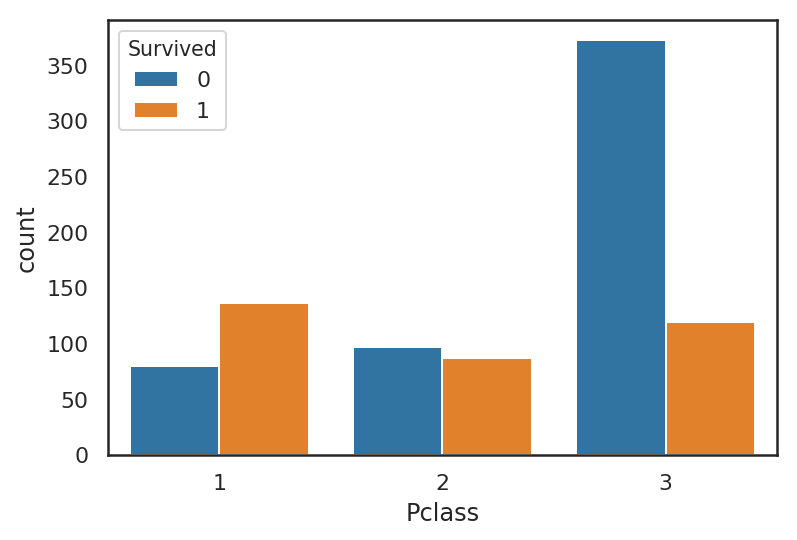

In [7]:
# Pclass
ax_pc = sns.countplot(x='Pclass',
                   hue="Survived",
                   data=traindata)

traindata[['Pclass',
           'Survived']].groupby('Pclass').count().sort_values(by='Survived',
                                                                    ascending=False)

Text(0, 0.5, 'Survival Probability')

,Survived
Pclass,
1,0.629630
2,0.472826
3,0.242363


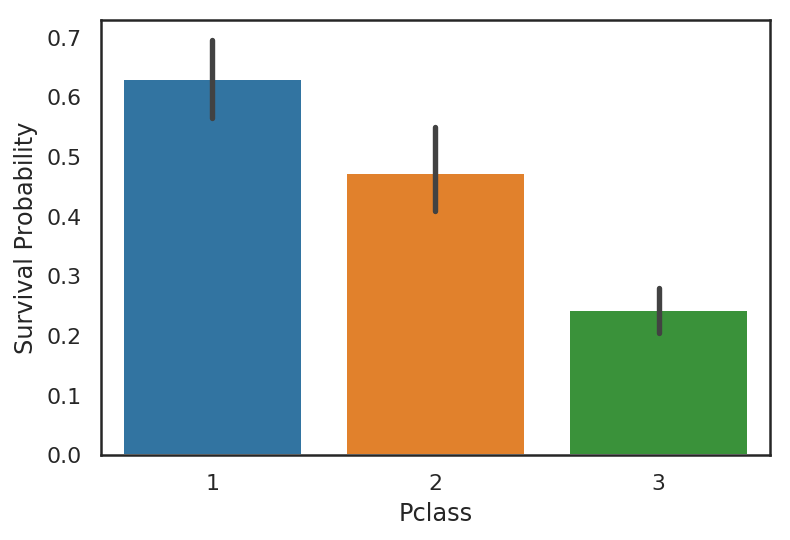

In [8]:
ax_pp = sns.barplot(x='Pclass',
                   y='Survived',
                   data=traindata)

ax_pp.set_ylabel("Survival Probability")

traindata[['Pclass',
           'Survived']].groupby(['Pclass']).mean().sort_values(by='Survived',
                                                             ascending=False)

#### Names

In [9]:
# Names

Prefixes = ['Mr.','Mrs.',
            'Master.','Miss.',
            'Don.','Dr.','Rev.',
            'Col.','Major.',
            'Ms.','Mme.','Lady.',
            'Sir.','Mlle.','Countess.',
            'Capt.','Jonkheer.']

def apply_prefix(s) -> str:
    
    Prefixes = ['Mr.','Mrs.','Master.','Miss.',
                'Don.','Dr.','Rev.','Col.',
                'Major.','Ms.','Mme.','Lady.','Dona.',
                'Sir.','Mlle.','Countess.','Capt.','Jonkheer.']
    
    for _pf_ in Prefixes:
        if _pf_ in s:
            return _pf_
    print(f'iSNAN:{s}')
    return None

Pf_data = traindata.loc[:,('Name','Survived','Fare', 'Age')]
Pf_data['Prefix'] = traindata.copy().loc[:,'Name'].astype(str).apply(apply_prefix) 

Text(0, 0.5, 'Survival Probability by Title')

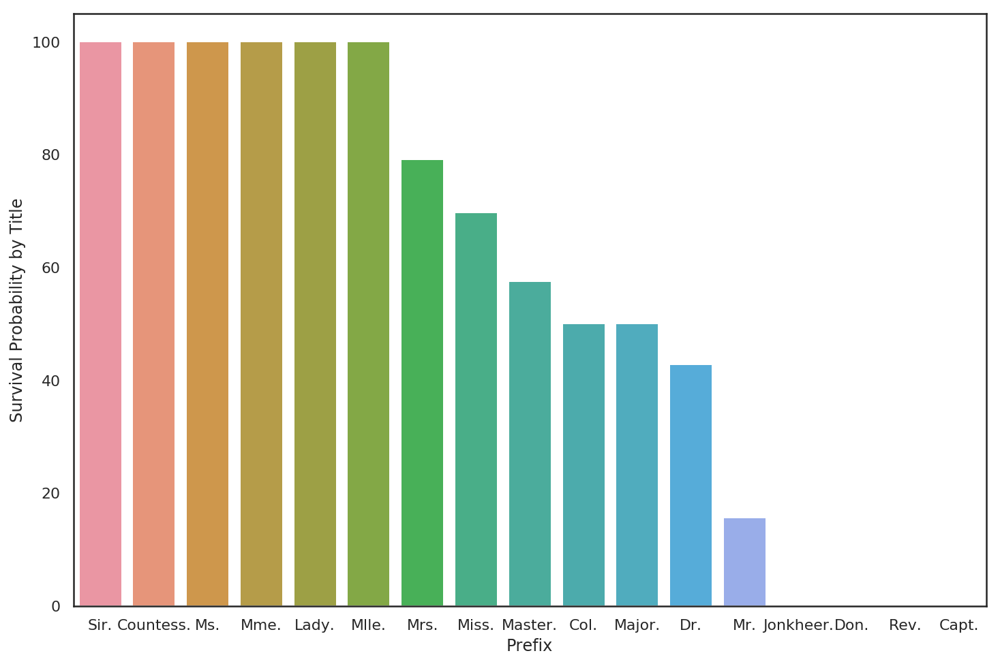

In [10]:
P = Pf_data[['Prefix',
             'Survived']].groupby('Prefix').mean().sort_values(by='Survived',
                                                               ascending=False) * 100
C = Pf_data[['Prefix', 'Survived']].groupby('Prefix').count()

C['Counts'] = Pf_data['Prefix'].value_counts()
C['Avg. Fare'] = Pf_data[['Prefix', 'Fare']].groupby('Prefix').mean()
C['Avg. Age'] = Pf_data[['Prefix', 'Age']].groupby('Prefix').mean()

byNames = pd.merge(P,C,how='outer',on='Prefix')
byNames.columns = ['Survived(%)','Survived(N)', 'Counts(N)', 'Avg. Fare', 'Avg. Age']
byNames.index.name='Prefix'

fig = plt.figure(figsize=(12,8))

ax_np = sns.barplot(x=byNames.index,y=byNames['Survived(%)'])
ax_np.set_ylabel('Survival Probability by Title')

In [11]:
# Prefix, and how it stacks up with some other predictors
byNames

,Survived(%),Survived(N),Counts(N),Avg. Fare,Avg. Age
Prefix,,,,,
Sir.,100.000000,1,1,56.929200,49.000000
Countess.,100.000000,1,1,86.500000,33.000000
Ms.,100.000000,1,1,13.000000,28.000000
Mme.,100.000000,1,1,69.300000,24.000000
Lady.,100.000000,1,1,39.600000,48.000000
Mlle.,100.000000,2,2,59.402100,24.000000
Mrs.,79.200000,125,125,45.138533,35.898148
Miss.,69.780220,182,182,43.797873,21.773973
Master.,57.500000,40,40,34.703125,4.574167


#### Gender

Text(0, 0.5, 'Survival Probability')

,Survived
Sex,
female,0.742038
male,0.188908


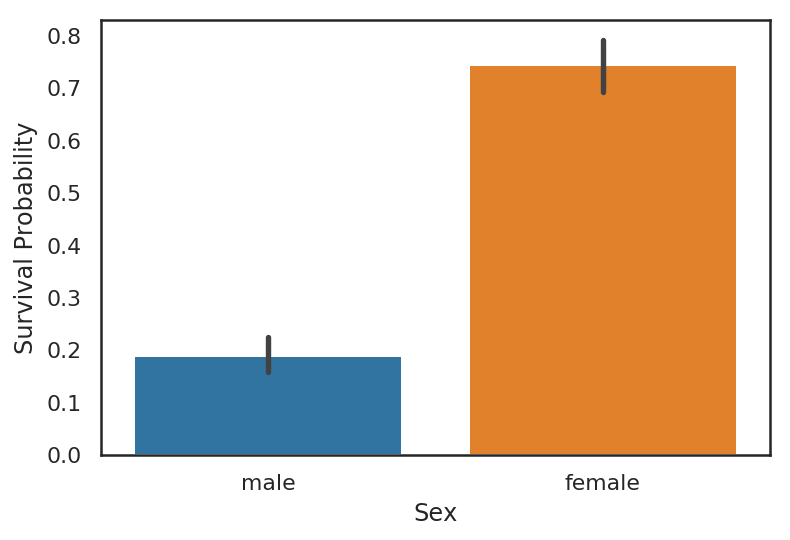

In [12]:
# by Gender

ax_gn = sns.barplot(x='Sex',y='Survived',data=traindata)
ax_gn.set_ylabel('Survival Probability')

traindata[['Sex','Survived']].groupby(['Sex']).mean()

#### Age

Text(0.5, 1.0, 'Survivors v/s Non Survivors by Age')

Text(0.5, 0, 'Age')

Text(0, 0.5, 'Probability')

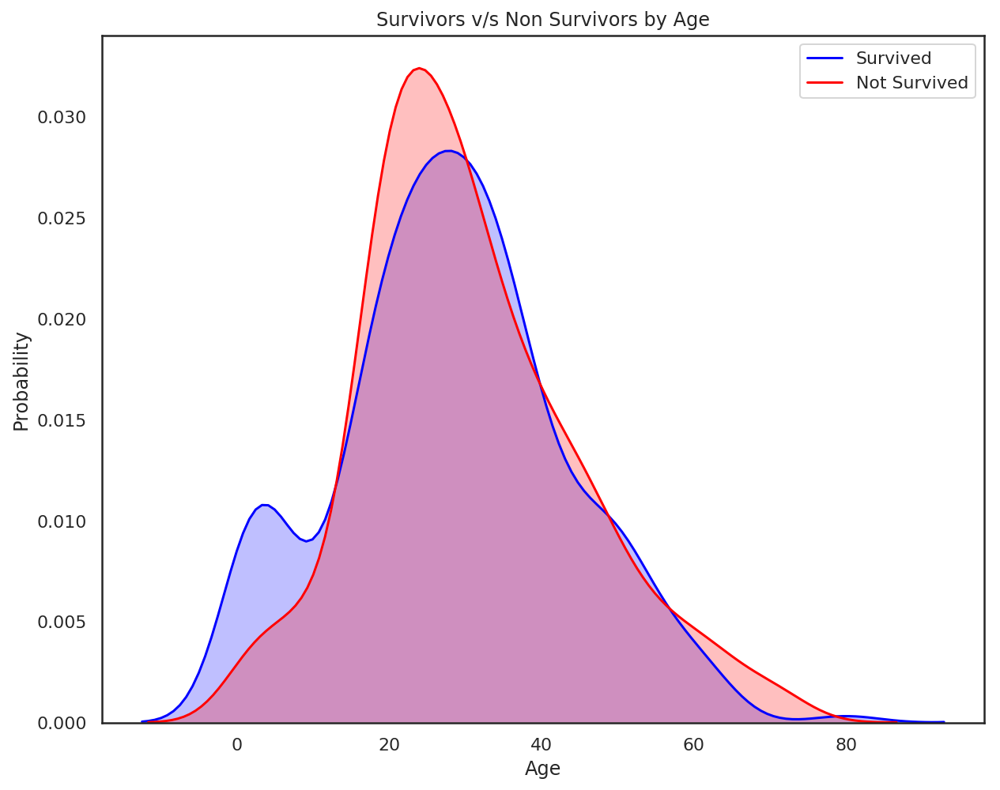

In [13]:
# by Age - Continuous

fig = plt.figure(figsize=(10,8))

ax = sns.kdeplot(traindata.loc[(traindata['Survived']==1),('Age')],
                 color='b',
                 shade=True,
                 label='Survived')

ax = sns.kdeplot(traindata.loc[(traindata['Survived']==0),('Age')],
                 color='r',
                 shade=True,
                 label='Not Survived')

plt.title('Survivors v/s Non Survivors by Age')
plt.xlabel('Age')
plt.ylabel('Probability')

Text(0, 0.5, 'Survival Probability by Age Group')

,Survived
Age_Binned,
0-10,0.593750
10-20,0.382609
20-30,0.365217
30-40,0.445161
40-50,0.383721
50-60,0.404762
60-70,0.235294
70-80,0.200000


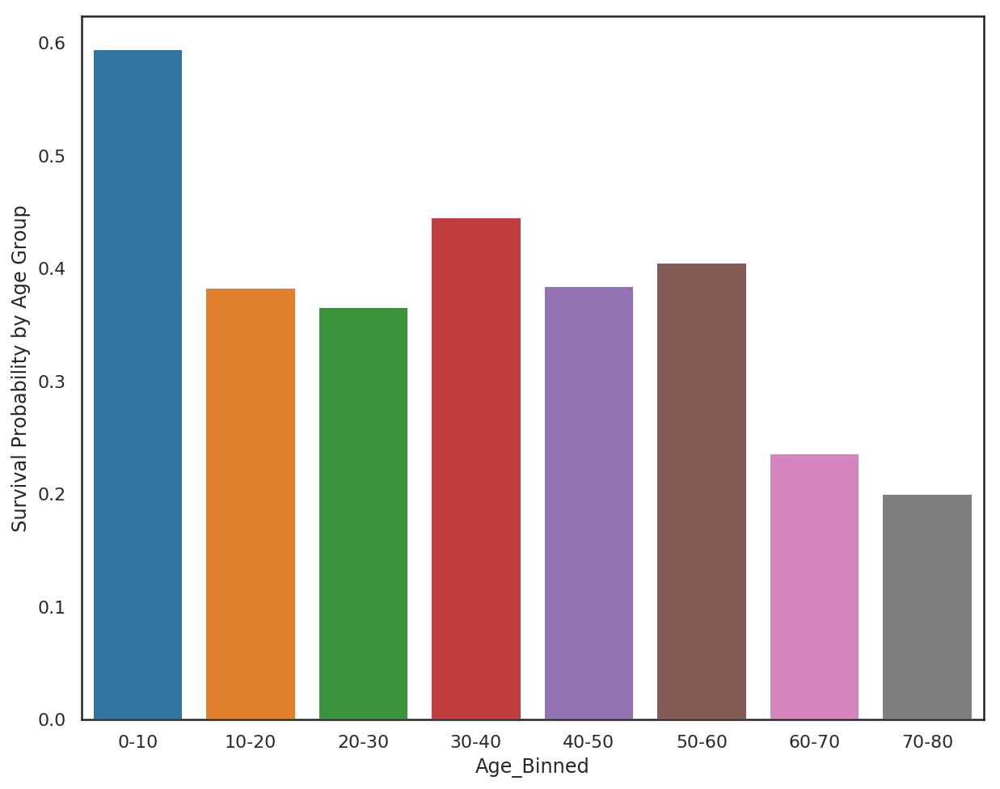

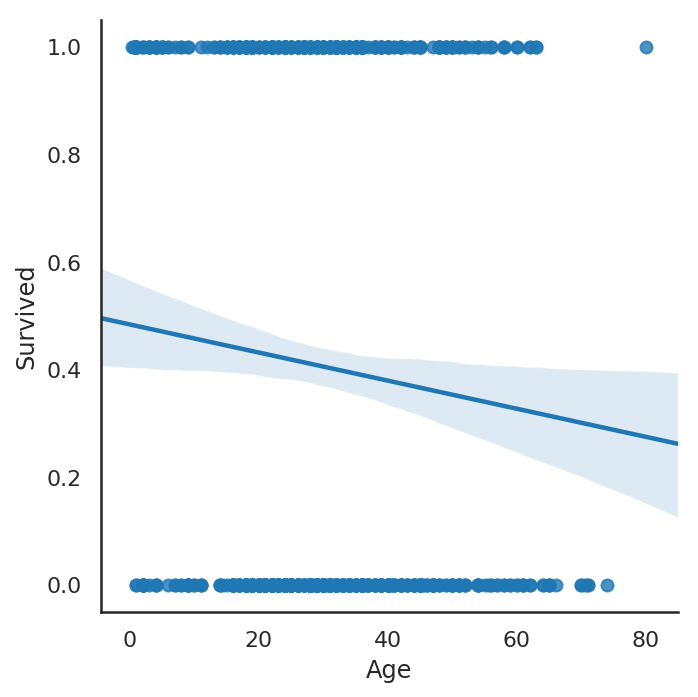

In [14]:
# by Age - Discrete Age Binning

fig = plt.figure(figsize=(10,8))

ageDF = traindata[['Age','Survived']]

maxage, minage = int(ageDF.Age.max()), int(ageDF.Age.min())
agebins = np.arange(minage, maxage+10, 10)
agelabels = [str(agebins[i])+'-'+str(agebins[i+1])
             for i in range(len(agebins)-1)]


ageDF['Age_Binned'] = pd.cut(ageDF.loc[:,('Age')],
                             bins=agebins,
                             labels=agelabels)


Binned_Probs = ageDF[['Age_Binned','Survived']].groupby(['Age_Binned']).mean()

ax_ag = sns.barplot(x=Binned_Probs.index,
                    y='Survived', 
                    data=Binned_Probs)

ax_lmag = sns.lmplot('Age','Survived',data=ageDF)

ax_ag.set_ylabel('Survival Probability by Age Group')

Binned_Probs

#### SibSp

Text(0, 0.5, 'Survival Probabibility')

Text(0.5, 0, 'Number of siblings on board')

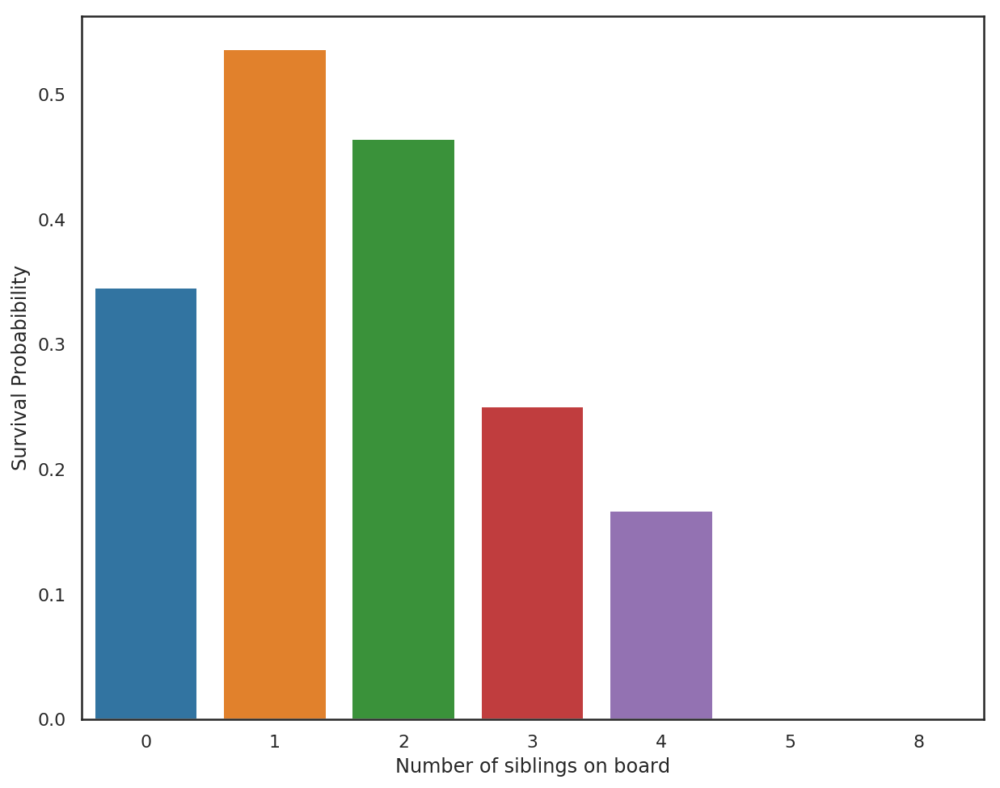

In [15]:
# by siblings on board

fig = plt.figure(figsize=(10,8))

sib_data = traindata[['SibSp', 'Survived']].groupby(['SibSp']).mean()

ax_sb = sns.barplot(x=sib_data.index, y='Survived', data=sib_data)
ax_sb.set_ylabel('Survival Probabibility')
ax_sb.set_xlabel('Number of siblings on board')

#### Parch

Text(0, 0.5, 'Survival Probabibility')

,Survived
Parch,
0,0.343658
1,0.550847
2,0.500000
3,0.600000
4,0.000000
5,0.200000
6,0.000000


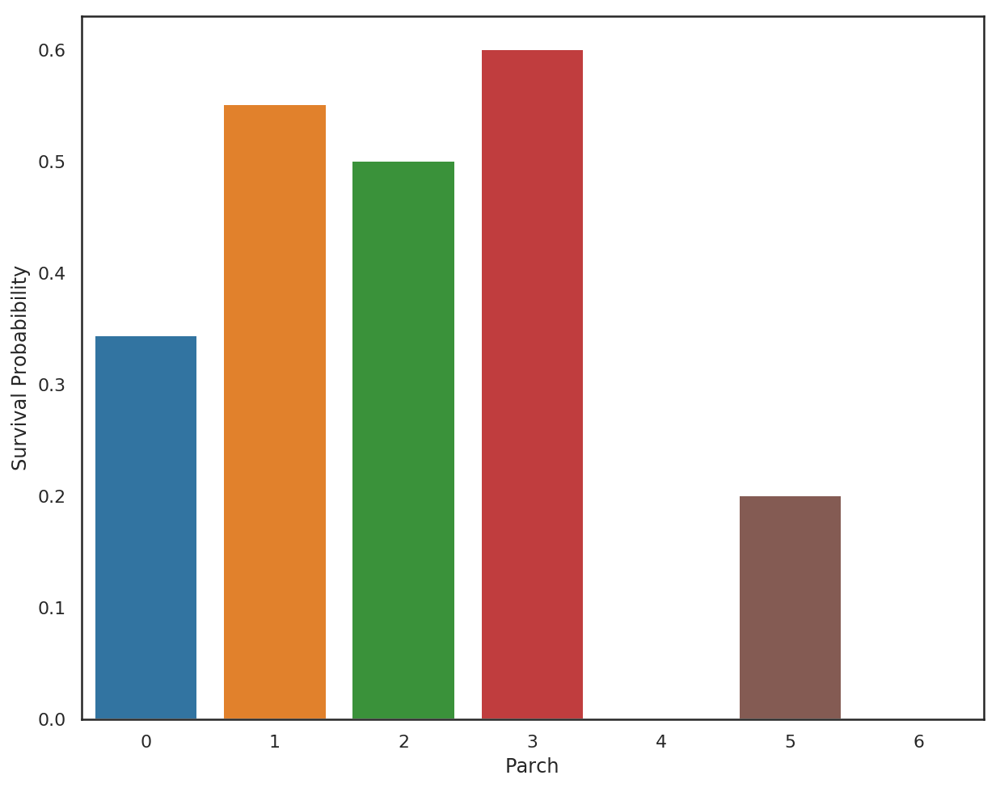

In [16]:
# by parents on board

fig = plt.figure(figsize=(10,8))

Parch_data = traindata[['Parch', 'Survived']].groupby(['Parch']).mean()

ax_sb = sns.barplot(x=Parch_data.index, y='Survived', data=Parch_data)
ax_sb.set_ylabel('Survival Probabibility')

Parch_data

#### Fares

Text(0.5, 1.0, 'Survivors v/s Non Survivors by Fare')

Text(0.5, 0, 'Fare')

Text(0, 0.5, 'Probability')

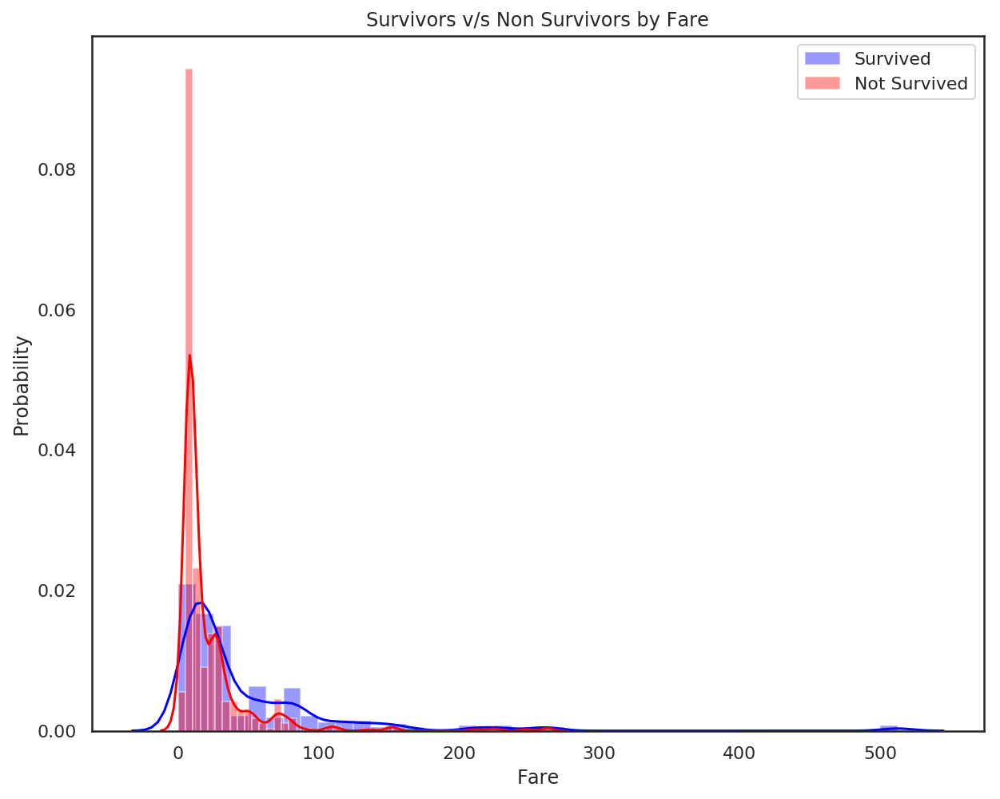

In [17]:
# by fares

fig = plt.figure(figsize=(10,8))

ax = sns.distplot(traindata.loc[(traindata['Survived']==1),('Fare')],
                 color='b',
                 label='Survived')

ax = sns.distplot(traindata.loc[(traindata['Survived']==0),('Fare')],
                 color='r',
                 label='Not Survived')

plt.title('Survivors v/s Non Survivors by Fare')
plt.legend()
plt.xlabel('Fare')
plt.ylabel('Probability')

#### Cabin

In [18]:
# Cabin
traindata['Cabin'].unique()

array([nan, 'C85', 'C123', 'E46', 'G6', 'C103', 'D56', 'A6',
       'C23 C25 C27', 'B78', 'D33', 'B30', 'C52', 'B28', 'C83', 'F33',
       'F G73', 'E31', 'A5', 'D10 D12', 'D26', 'C110', 'B58 B60', 'E101',
       'F E69', 'D47', 'B86', 'F2', 'C2', 'E33', 'B19', 'A7', 'C49', 'F4',
       'A32', 'B4', 'B80', 'A31', 'D36', 'D15', 'C93', 'C78', 'D35',
       'C87', 'B77', 'E67', 'B94', 'C125', 'C99', 'C118', 'D7', 'A19',
       'B49', 'D', 'C22 C26', 'C106', 'C65', 'E36', 'C54',
       'B57 B59 B63 B66', 'C7', 'E34', 'C32', 'B18', 'C124', 'C91', 'E40',
       'T', 'C128', 'D37', 'B35', 'E50', 'C82', 'B96 B98', 'E10', 'E44',
       'A34', 'C104', 'C111', 'C92', 'E38', 'D21', 'E12', 'E63', 'A14',
       'B37', 'C30', 'D20', 'B79', 'E25', 'D46', 'B73', 'C95', 'B38',
       'B39', 'B22', 'C86', 'C70', 'A16', 'C101', 'C68', 'A10', 'E68',
       'B41', 'A20', 'D19', 'D50', 'D9', 'A23', 'B50', 'A26', 'D48',
       'E58', 'C126', 'B71', 'B51 B53 B55', 'D49', 'B5', 'B20', 'F G63',
       'C62 C64',

#### Embarked

Text(0, 0.5, 'Count')

,Survived
Embarked,
C,168
Q,77
S,644


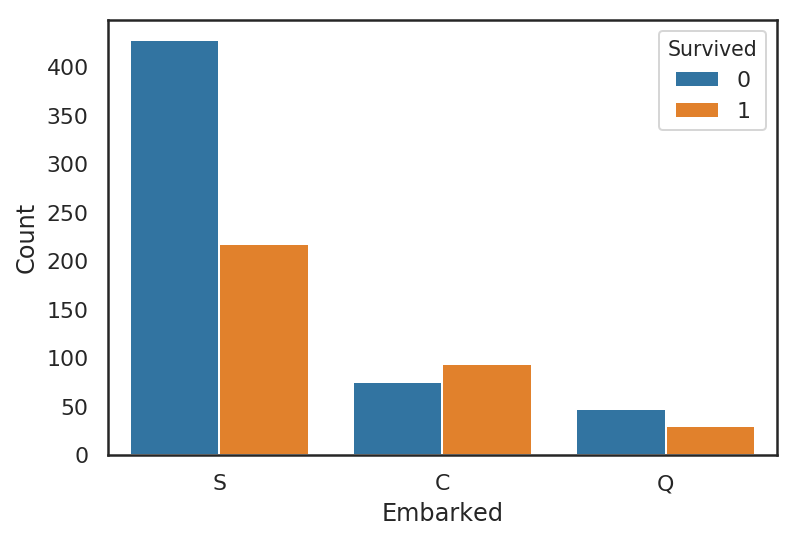

In [19]:
# Embarked
ax = sns.countplot(x='Embarked',hue='Survived',data=traindata)
ax.set_ylabel('Count')

traindata[['Embarked','Survived']].groupby(['Embarked']).count()

#### Extra (CatPlots)

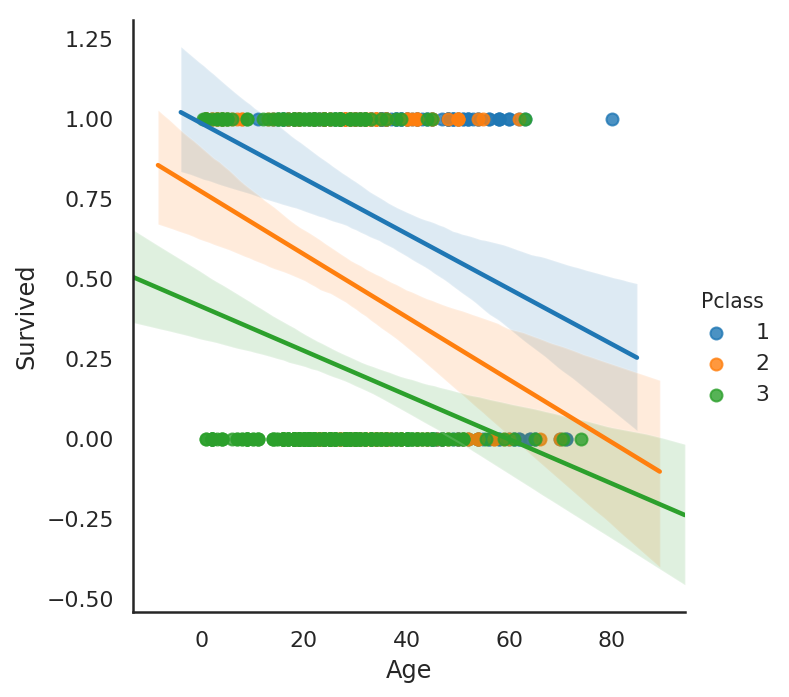

In [20]:
# Multiplots
# Age and Pclass

sns.lmplot('Age', 'Survived', data=traindata, hue='Pclass')

<Figure size 1152x384 with 0 Axes>

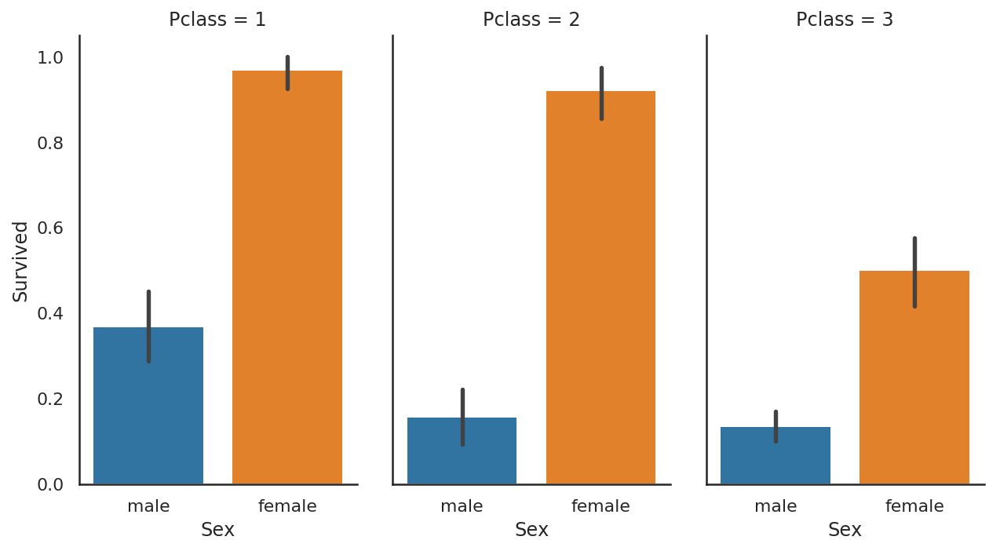

In [21]:
# Age, Sex and Pclass
fig = plt.figure(figsize=(12,4), dpi=96)
sns.catplot(x='Sex', y='Survived', col='Pclass', 
            data=traindata, kind='bar', aspect=0.6)

<Figure size 2688x384 with 0 Axes>

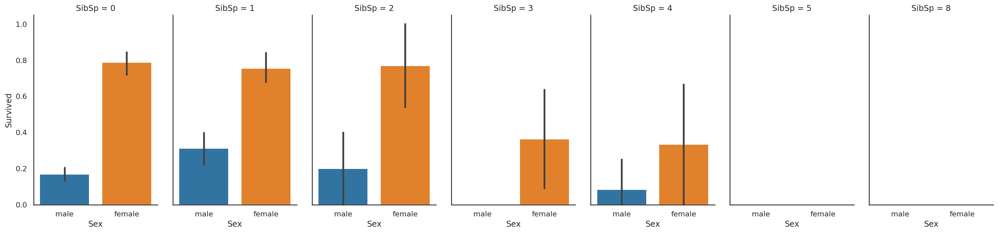

In [22]:
# Age, Sex, and Siblings on board
fig = plt.figure(figsize=(28,4), dpi=96)
sns.catplot(x='Sex', y='Survived', col='SibSp', 
            data=traindata, kind='bar', aspect=0.6)

<Figure size 2688x384 with 0 Axes>

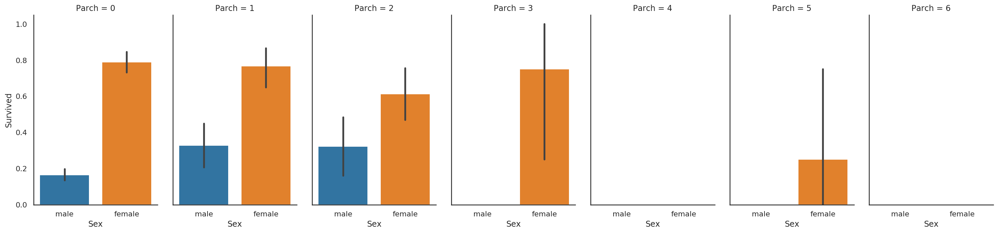

In [23]:
#Age, Sex and Parch
fig = plt.figure(figsize=(28,4), dpi=96)
sns.catplot(x='Sex', y='Survived', col='Parch', 
            data=traindata, kind='bar', aspect=0.6)

## Feature Engineering

* Goals:
    * Clean up and prepare all features for model.
        * Impute missing data to be closer to the distribution of actual non-missing data (?)*
        * Reduce any unnecessary dimensionality
        * Discard unique features that are not helpful predictors.
    * Use automated feature tools to augment the already existing and cleaned up data with helpful predictors.
    * Test features for predictability.

### Clean up and prepare non missing data.

In [24]:
# combining data

traindata['origin'] = 'train'
testdata['origin'] = 'test'
alldata = pd.concat([traindata, testdata], ignore_index=True, sort=False)
print(traindata.shape, testdata.shape, alldata.shape)
print(set(traindata.columns) - set(testdata.columns))

alldata.isna().sum()

(891, 13) (418, 12) (1309, 13)
{'Survived'}


PassengerId       0
Survived        418
Pclass            0
Name              0
Sex               0
Age             263
SibSp             0
Parch             0
Ticket            0
Fare              1
Cabin          1014
Embarked          2
origin            0
dtype: int64

In [25]:
alldata.set_index('PassengerId', inplace=True)
alldata.head()

,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,origin
PassengerId,,,,,,,,,,,,
1,0.0,3,"Braund, Mr. Owen Harris",male,22.0,1,0,A/5 21171,7.2500,NaN,S,train
2,1.0,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.0,1,0,PC 17599,71.2833,C85,C,train
3,1.0,3,"Heikkinen, Miss. Laina",female,26.0,0,0,STON/O2. 3101282,7.9250,NaN,S,train
4,1.0,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.0,1,0,113803,53.1000,C123,S,train
5,0.0,3,"Allen, Mr. William Henry",male,35.0,0,0,373450,8.0500,NaN,S,train


In [26]:
# typecast survival to bool

alldata['Survived'] = alldata.Survived.map(lambda s: np.bool(s) if not \
                                           np.isnan(s) else np.nan)

alldata.loc[alldata.origin=='test', :].head()

,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,origin
PassengerId,,,,,,,,,,,,
892,NaN,3,"Kelly, Mr. James",male,34.5,0,0,330911,7.8292,NaN,Q,test
893,NaN,3,"Wilkes, Mrs. James (Ellen Needs)",female,47.0,1,0,363272,7.0000,NaN,S,test
894,NaN,2,"Myles, Mr. Thomas Francis",male,62.0,0,0,240276,9.6875,NaN,Q,test
895,NaN,3,"Wirz, Mr. Albert",male,27.0,0,0,315154,8.6625,NaN,S,test
896,NaN,3,"Hirvonen, Mrs. Alexander (Helga E Lindqvist)",female,22.0,1,1,3101298,12.2875,NaN,S,test


Keeping a mix of Categorical and Numerical Columns, all discrete.

In [27]:
# Pclass - make categorical
alldata['Pclass'] = alldata.Pclass.astype('category')
alldata['Pclass'].value_counts()

3    709
1    323
2    277
Name: Pclass, dtype: int64

In [28]:
Prefixmap = {
             'Sir.': 'MaleRarePos', 'Ms.': 'FemaleRarePos', 
             'Mme.': 'FemaleRarePos', 'Lady.': 'FemaleRarePos',
             'Mlle.': 'FemaleRarePos', 'Countess.': 'FemaleRarePos',
             'Mrs.': 'Mrs', 'Miss.': 'Miss', 'Master.': 'Master',
             'Dona.': 'FemaleRarePos', 'Mr.': 'Mr', 'Col.': 'MaleRareMaybes',
             'Major.': 'MaleRareMaybes', 'Dr.': 'MaleRareMaybes',
             'Don.': 'MaleRareNeg', 'Rev.': 'MaleRareNeg',
             'Capt.': 'MaleRareNeg', 'Jonkheer.': 'MaleRareNeg', 'nan':'nan'
            }

In [29]:
# Name - Extract Prefixes
# apply_prefixes from function
alldata['Prefix'] = alldata.astype(str).apply(lambda s: pd.Series(apply_prefix(s["Name"])),axis=1)

# reduce prefixes to most important ones 
alldata['Prefix'] = alldata.Prefix.map(lambda x: Prefixmap[x])

print(alldata.Prefix.unique())
alldata['Prefix'] = alldata.Prefix.astype('category').cat.codes + 1
alldata['Prefix'] = alldata['Prefix'].astype('category')
alldata['Prefix'].value_counts()

['Mr' 'Mrs' 'Miss' 'Master' 'MaleRareNeg' 'MaleRareMaybes' 'FemaleRarePos'
 'MaleRarePos']


7    757
6    260
8    197
5     61
2     14
3     11
1      8
4      1
Name: Prefix, dtype: int64

In [30]:
# check progress
alldata.columns

Index(['Survived', 'Pclass', 'Name', 'Sex', 'Age', 'SibSp', 'Parch', 'Ticket',
       'Fare', 'Cabin', 'Embarked', 'origin', 'Prefix'],
      dtype='object')

In [31]:
#Name -> Drop Raw Names
alldata.drop(labels = ['Name'], axis=1, inplace=True)
# check progress
alldata.columns

Index(['Survived', 'Pclass', 'Sex', 'Age', 'SibSp', 'Parch', 'Ticket', 'Fare',
       'Cabin', 'Embarked', 'origin', 'Prefix'],
      dtype='object')

In [32]:
#Sex -> Categorize
alldata['Sex'] = alldata.Sex.astype('category').cat.codes + 1
alldata['Sex'] = alldata.Sex.astype('category')
alldata['Sex'].value_counts(), alldata['Sex'].dtype

(2    843
 1    466
 Name: Sex, dtype: int64, CategoricalDtype(categories=[1, 2], ordered=False))

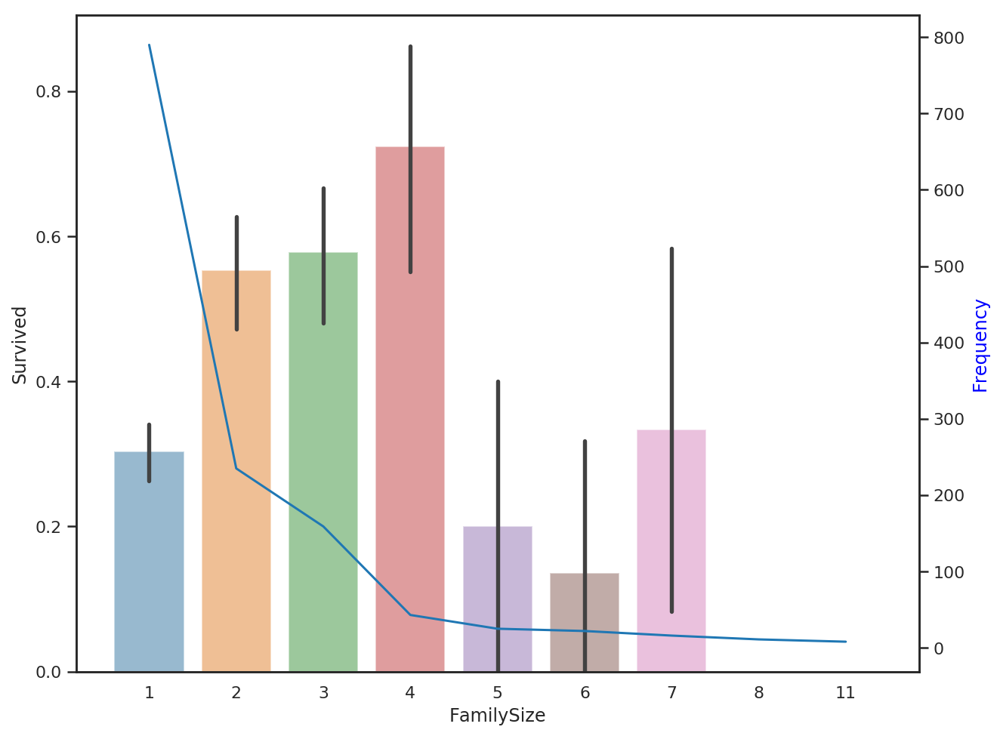

In [33]:
# SibSp and Parch -> Family Size

# switch of scipy.stats warning for enforced use of arr[np.array(seq)]
np.warnings.filterwarnings('ignore')

alldata[('FamilySize')] = alldata[('SibSp')] + alldata[('Parch')] + 1

fig = plt.figure(figsize=(10,8))
ax = fig.add_subplot(111)

ax = sns.barplot(x='FamilySize',y='Survived',data=alldata,alpha=0.5)
for c in ax.patches:
    c.set_zorder(0)

ax2 = ax.twinx()
_ = sns.lineplot(x=np.arange(0, len(alldata.FamilySize.unique())),
                        y=alldata.FamilySize.value_counts(),ax=ax2)

_ = ax2.set_ylabel('Frequency', color='b')

In [34]:
# Cat Codes for FamilySize, SibSp and Parch

alldata['FamilySize'] = alldata.FamilySize.astype(np.uint8)
print(alldata.FamilySize.value_counts(), alldata.FamilySize.dtype)

alldata['SibSp'] = alldata.SibSp.astype(np.uint8)
alldata['Parch'] = alldata.Parch.astype(np.uint8)

print(alldata.SibSp.value_counts(), alldata.SibSp.dtype)
print(alldata.Parch.value_counts(), alldata.Parch.dtype)

1     790
2     235
3     159
4      43
6      25
5      22
7      16
11     11
8       8
Name: FamilySize, dtype: int64 uint8
0    891
1    319
2     42
4     22
3     20
8      9
5      6
Name: SibSp, dtype: int64 uint8
0    1002
1     170
2     113
3       8
5       6
4       6
9       2
6       2
Name: Parch, dtype: int64 uint8


In [35]:
def parse_ticket(s:str)->(str, int):
    if s.strip(" ").isnumeric():
        return float('NaN'), int(s)
    elif s.strip(" ").isalpha():
        return s.strip(" "), int(0)
    else:
        try:
            xstr = s.replace('.','').replace('/','').strip(' ').split(' ')
            s,i = ''.join(xstr[0:-1]),xstr[-1]
            return s, int(i)
        except:
            xstr = s.replace('.','').replace('/','').strip(' ').split(' ')
            ss,i = ''.join(xstr[0:-1]),xstr[-1]
            print(s,ss, i)
    
alldata[["TKTHEADER","TKTNUM"]] = alldata.apply(lambda s: pd.Series(parse_ticket(s["Ticket"])),
                                                               axis=1)
alldata[['TKTHEADER','TKTNUM']].head()

,TKTHEADER,TKTNUM
PassengerId,,
1,A5,21171.0
2,PC,17599.0
3,STONO2,3101282.0
4,NaN,113803.0
5,NaN,373450.0


In [36]:
# cleaning up ticket data

alldata.drop(labels=['Ticket'], axis=1, inplace=True)

alldata['TKTHEADER'] = alldata.TKTHEADER.astype(str)
alldata['TKTNUM'] = alldata.TKTNUM.astype(np.int64)

alldata['TKTHEADER'] = alldata.TKTHEADER.astype('category').cat.codes + 1
alldata['TKTHEADER'] = alldata.TKTHEADER.astype('category')

alldata['TKTNUM'] = alldata.TKTNUM.astype('category').cat.codes + 1
alldata['TKTNUM'] = alldata.TKTNUM.astype('category')

print(alldata.TKTNUM.value_counts(), alldata.TKTNUM.dtype)
print(alldata.TKTHEADER.value_counts(), alldata.TKTHEADER.dtype)

40     11
25      8
18      8
909     7
671     7
666     7
269     7
219     7
448     6
676     6
856     6
293     6
278     5
134     5
436     5
752     5
474     5
224     5
149     5
74      4
81      4
148     4
189     4
370     4
442     4
361     4
230     4
39      4
481     4
380     4
       ..
571     1
570     1
569     1
592     1
594     1
618     1
607     1
617     1
616     1
615     1
614     1
613     1
612     1
611     1
610     1
609     1
608     1
606     1
595     1
605     1
604     1
603     1
602     1
601     1
600     1
599     1
598     1
597     1
596     1
462     1
Name: TKTNUM, Length: 924, dtype: int64 category
37    957
15     92
8      68
3      28
30     24
32     21
35     15
24     14
2      10
11      9
7       8
26      8
28      7
25      5
13      4
36      4
21      4
16      4
10      3
29      3
18      2
17      2
20      2
34      2
6       1
9       1
4       1
5       1
19      1
12      1
14      1
22      1
23      1
27      1
3

In [37]:
# Cabins

def parse_cabin(s):
    
    Decks = ['A','B','C','D','E','F','G','T']
    DeckSet = set()
    sc = s
    
    if type(s)==float:
        return float('NaN'), float('NaN')
    else:
        for deck_ in Decks:
            if deck_ in s:
                DeckSet.add(deck_)
                s = s.replace(deck_,"")
        if s == "":
            return tuple(DeckSet), float('NaN')
        else:
            Rooms = tuple(int(_s) for _s in s.strip(' ').split(' '))
            return tuple(DeckSet), tuple(Rooms)
        
alldata[['Deck','Cabin']] = alldata.apply(lambda s: pd.Series(parse_cabin(s["Cabin"])),axis=1)
alldata.loc[alldata['Deck'].notnull(), ('Deck','Cabin')].head()

,Deck,Cabin
PassengerId,,
2,"(C,)","(85,)"
4,"(C,)","(123,)"
7,"(E,)","(46,)"
11,"(G,)","(6,)"
12,"(C,)","(103,)"


In [38]:
alldata['Deck'] = alldata['Deck'].map(lambda s: 'N/A' if type(s)!=tuple else ''.join(s))
alldata['Cabin'] = alldata['Cabin'].map(lambda s: 'N/A' if type(s)!=tuple else len(s))
alldata.Deck.unique(), alldata.Cabin.unique()

(array(['N/A', 'C', 'E', 'G', 'D', 'A', 'B', 'F', 'GF', 'EF', 'T'],
       dtype=object), array(['N/A', 1, 3, 2, 4], dtype=object))

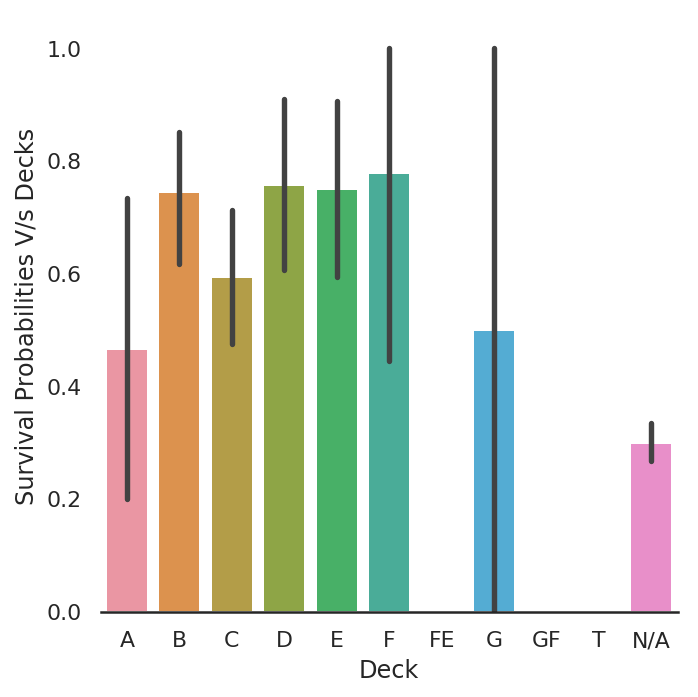

In [39]:
ax_dk  = sns.factorplot(x="Deck",y="Survived",data=alldata,kind="bar"
                        ,order=['A','B','C','D','E','F','FE','G','GF','T','N/A'])
ax_dk.despine(left=True)
ax_dk = ax_dk.set_ylabels("Survival Probabilities V/s Decks")

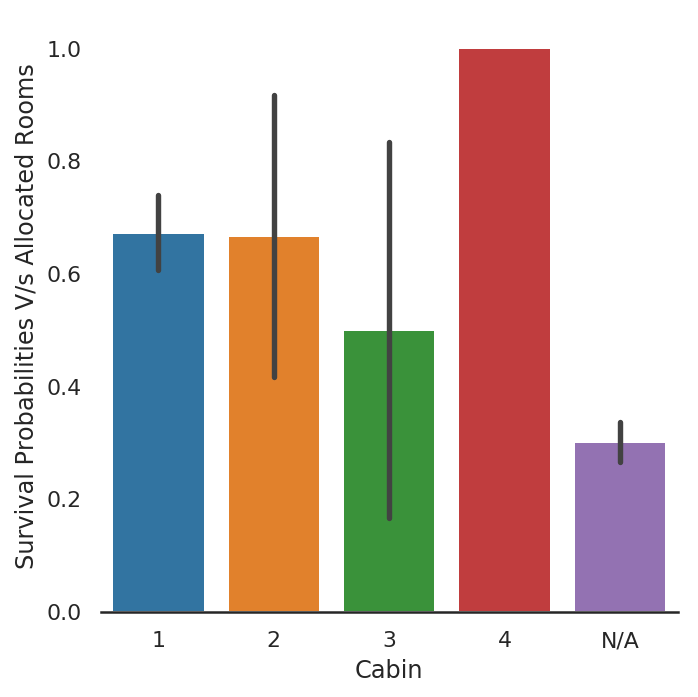

In [40]:
ax_cb  = sns.factorplot(x="Cabin",y="Survived",data=alldata,kind="bar"
                        ,order=[1,2,3,4,'N/A'])
ax_cb.despine(left=True)
ax_cb = ax_cb.set_ylabels("Survival Probabilities V/s Allocated Rooms")

In [41]:
alldata['Deck'] = alldata.Deck.astype('category').cat.codes + 1
alldata['Cabin'] = alldata.Cabin.astype('category').cat.codes + 1
alldata['Deck'] = alldata.Deck.astype('category')
alldata['Cabin'] = alldata.Cabin.astype('category')
print(alldata.Deck.value_counts(), alldata.Deck.dtype)
print(alldata.Cabin.value_counts(), alldata.Cabin.dtype)

10    1014
3       94
2       65
4       46
5       41
1       22
7       14
8        5
9        4
6        3
11       1
Name: Deck, dtype: int64 category
5    1020
1     255
2      19
3      10
4       5
Name: Cabin, dtype: int64 category


In [42]:
# check progress
print(list(alldata.columns))

['Survived', 'Pclass', 'Sex', 'Age', 'SibSp', 'Parch', 'Fare', 'Cabin', 'Embarked', 'origin', 'Prefix', 'FamilySize', 'TKTHEADER', 'TKTNUM', 'Deck']


### Imputation for Age, Fare & Embarked

In [43]:
def KNNfill(df,usecols,predcol, knn_k=5):
    
    dfcpy = df.copy().fillna(value=float('NaN')).loc[:, usecols]
    minval = dfcpy.loc[dfcpy[predcol].notnull(),(predcol)].min()
    meanval = dfcpy.loc[dfcpy[predcol].notnull(),(predcol)].mean()
    maxval = dfcpy.loc[dfcpy[predcol].notnull(),(predcol)].max()
    
    predictor = KNN(k=knn_k, min_value=minval, max_value=maxval)
    print("Starting Imputation, Printing NaNs for Passed DataFrame::\n{}\n".format(dfcpy.isnull().sum()))
    print("{} values missing for {}".format(dfcpy[predcol].isnull().sum(),predcol))
    imputed_df = pd.DataFrame(data=predictor.fit_transform(dfcpy),
                             columns=usecols)
    imputed_df.index = dfcpy.index
    imputed_df['orig_'+predcol] = dfcpy.loc[:, (predcol)]
    return imputed_df

In [44]:
usecols = ['Pclass', 'Sex', 'Age', 'SibSp',
           'Parch', 'Fare', 'Cabin', 'Prefix',
           'FamilySize', 'TKTHEADER', 'TKTNUM',
           'Deck']

# fill Fare with mean
tempfare = alldata.copy()
tempfare.loc[np.isnan(alldata.Fare),['Fare']] = tempfare.loc[:,'Fare'].mean()

imputed_df = KNNfill(tempfare, usecols, 'Age')

print("OK!" if imputed_df.Age.isnull().sum()==0 else "Imputation Failed!")

# compare with Original NaN's
imputed_df.loc[imputed_df['orig_Age'].isnull(),('orig_Age','Age')].head()
imputed_df['Survived'] = alldata.Survived

print(f'Min:{imputed_df.Age.min()} Max:{imputed_df.Age.max()}')

Starting Imputation, Printing NaNs for Passed DataFrame::
Pclass          0
Sex             0
Age           263
SibSp           0
Parch           0
Fare            0
Cabin           0
Prefix          0
FamilySize      0
TKTHEADER       0
TKTNUM          0
Deck            0
dtype: int64

263 values missing for Age
Imputing row 1/1309 with 0 missing, elapsed time: 0.202
Imputing row 101/1309 with 0 missing, elapsed time: 0.203
Imputing row 201/1309 with 0 missing, elapsed time: 0.203
Imputing row 301/1309 with 1 missing, elapsed time: 0.204
Imputing row 401/1309 with 0 missing, elapsed time: 0.205
Imputing row 501/1309 with 0 missing, elapsed time: 0.205
Imputing row 601/1309 with 0 missing, elapsed time: 0.206
Imputing row 701/1309 with 0 missing, elapsed time: 0.207
Imputing row 801/1309 with 0 missing, elapsed time: 0.207
Imputing row 901/1309 with 0 missing, elapsed time: 0.208
Imputing row 1001/1309 with 0 missing, elapsed time: 0.208
Imputing row 1101/1309 with 0 missing, elapsed t

,orig_Age,Age
PassengerId,,
6,NaN,25.718596
18,NaN,27.964362
20,NaN,21.680611
27,NaN,35.901648
29,NaN,18.816554


Min:0.17 Max:80.0


[1 2 3 4 5 6]


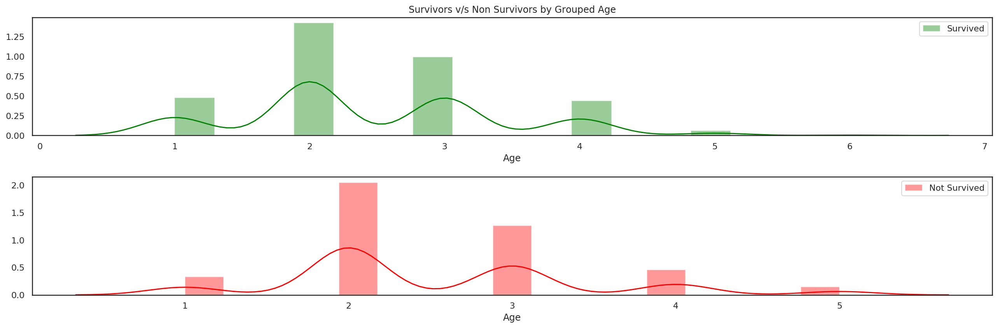

In [45]:
# discretize age to 10 year bins.

imputed_df['Age'] = imputed_df['Age'].map(lambda s: int((int(s)//15)+1))
imputed_df['Age'] = imputed_df['Age'].astype(np.int8)
print(np.sort(imputed_df.Age.unique()))

# plot
fig, ax_ag = plt.subplots(2, 1, figsize=(18,6))

ax_ag[0] = sns.distplot(imputed_df.loc[(imputed_df['Survived']==1),('Age')], 
                        bins=17, color='g', kde=True, hist=True,
                        label='Survived', ax = ax_ag[0])
ax_ag[1] = sns.distplot(imputed_df.loc[(imputed_df['Survived']==0),('Age')],
                        bins=17, color='r', kde=True, hist=True,
                        label='Not Survived', ax = ax_ag[1])
_ = ax_ag[0].set_title('Survivors v/s Non Survivors by Grouped Age', loc='center')
_ = ax_ag[0].legend()
_ = ax_ag[1].legend()
plt.tight_layout()

In [46]:
# assign and cast
alldata['Age'] = imputed_df.Age
alldata['Age'] = alldata.Age.astype(np.uint8)
alldata['Age'].value_counts()

2    616
3    369
4    157
1    127
5     38
6      2
Name: Age, dtype: int64

In [47]:
# Fares
print(alldata['Fare'].isnull().sum())

usecols = set(alldata.columns) - set(['Survived','origin','Embarked'])
predcol = 'Fare'

imputed_df = KNNfill(alldata,usecols,predcol,100)

1
Starting Imputation, Printing NaNs for Passed DataFrame::
Fare          1
Age           0
Sex           0
SibSp         0
Pclass        0
Prefix        0
FamilySize    0
Deck          0
Cabin         0
TKTHEADER     0
TKTNUM        0
Parch         0
dtype: int64

1 values missing for Fare
Imputing row 1/1309 with 0 missing, elapsed time: 0.189
Imputing row 101/1309 with 0 missing, elapsed time: 0.189
Imputing row 201/1309 with 0 missing, elapsed time: 0.189
Imputing row 301/1309 with 0 missing, elapsed time: 0.189
Imputing row 401/1309 with 0 missing, elapsed time: 0.190
Imputing row 501/1309 with 0 missing, elapsed time: 0.190
Imputing row 601/1309 with 0 missing, elapsed time: 0.190
Imputing row 701/1309 with 0 missing, elapsed time: 0.190
Imputing row 801/1309 with 0 missing, elapsed time: 0.190
Imputing row 901/1309 with 0 missing, elapsed time: 0.190
Imputing row 1001/1309 with 0 missing, elapsed time: 0.191
Imputing row 1101/1309 with 0 missing, elapsed time: 0.191
Imputing row

Median:16.31970147986134, Predicted:33.2954792813456


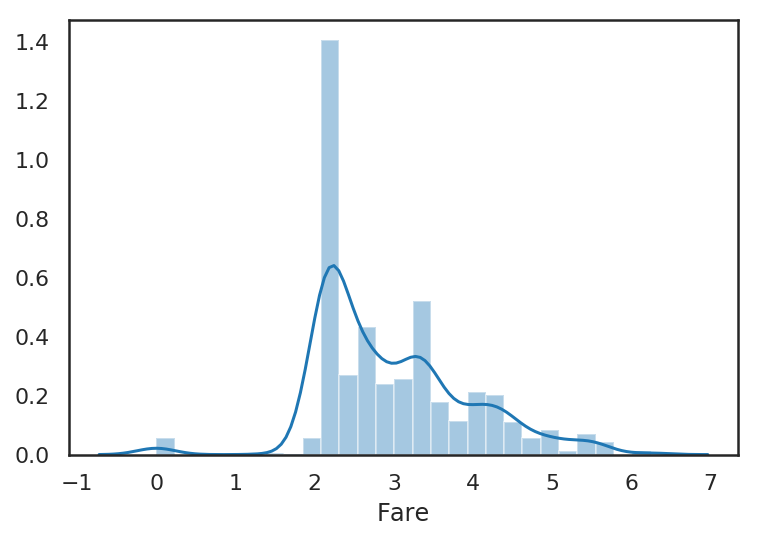

In [48]:
comp_fares = (float(imputed_df.loc[imputed_df['orig_Fare'].isnull(),('Fare')]),
              imputed_df.orig_Fare.mean())

print('Median:{}, Predicted:{}'.format(*comp_fares))

# logshift fares value 
alldata['Fare'] = np.log1p(imputed_df['Fare'])

sns.distplot(alldata['Fare'])

In [49]:
# discretizing fares

alldata['Fare'] = pd.qcut(alldata['Fare'], 4, labels=[1,2,3,4])
alldata['Fare'] = alldata.Fare.astype(np.uint8)
print(alldata.Fare.value_counts())

1    337
3    329
4    323
2    320
Name: Fare, dtype: int64


In [50]:
# Embarked
alldata['Embarked'].unique()

array(['S', 'C', 'Q', nan], dtype=object)

In [51]:
EmbMap = {'C':0, 'Q':1, 'S':2}

alldata['Embarked'] = alldata['Embarked'].map(lambda s: np.nan if type(s)==float else EmbMap[str(s)])

alldata['Embarked'].isnull().sum()

2

In [52]:
usecols = set(alldata.columns) - set(['Survived','origin'])
predcol = 'Embarked'

imputed_df = KNNfill(alldata,usecols,predcol,100)

Starting Imputation, Printing NaNs for Passed DataFrame::
Age           0
Fare          0
Embarked      2
SibSp         0
Sex           0
Pclass        0
Prefix        0
FamilySize    0
TKTNUM        0
Deck          0
TKTHEADER     0
Cabin         0
Parch         0
dtype: int64

2 values missing for Embarked
Imputing row 1/1309 with 0 missing, elapsed time: 0.186
Imputing row 101/1309 with 0 missing, elapsed time: 0.186
Imputing row 201/1309 with 0 missing, elapsed time: 0.186
Imputing row 301/1309 with 0 missing, elapsed time: 0.186
Imputing row 401/1309 with 0 missing, elapsed time: 0.187
Imputing row 501/1309 with 0 missing, elapsed time: 0.187
Imputing row 601/1309 with 0 missing, elapsed time: 0.187
Imputing row 701/1309 with 0 missing, elapsed time: 0.187
Imputing row 801/1309 with 0 missing, elapsed time: 0.187
Imputing row 901/1309 with 0 missing, elapsed time: 0.187
Imputing row 1001/1309 with 0 missing, elapsed time: 0.188
Imputing row 1101/1309 with 0 missing, elapsed time: 

In [53]:
alldata['Embarked'] = imputed_df['Embarked']
alldata['Embarked'] = alldata.Embarked.map(lambda s: int(s))

alldata.Embarked.value_counts()

2    914
0    270
1    125
Name: Embarked, dtype: int64

In [54]:
# cat codes, meow!
alldata['Embarked'] = alldata.Embarked.astype('category').cat.codes + 1
alldata['Embarked'] = alldata.Embarked.astype('category')
print(alldata.Embarked.value_counts())
print('\n',list(alldata.columns))

3    914
1    270
2    125
Name: Embarked, dtype: int64

 ['Survived', 'Pclass', 'Sex', 'Age', 'SibSp', 'Parch', 'Fare', 'Cabin', 'Embarked', 'origin', 'Prefix', 'FamilySize', 'TKTHEADER', 'TKTNUM', 'Deck']


In [55]:
# dropping TKT and Cabin Number features
alldata.drop(labels=['TKTNUM', 'TKTHEADER', 'Cabin'], axis=1, inplace=True)

### Verification (DTypes)

In [56]:
# forced typecasting

alldata['origin'] = alldata.origin.astype('category')
typesdict = {'object':[], 'categorical':[], 'numerical':[]}
uint8check = lambda x: True if x.max() <= 255 else False

for col in alldata.columns:
    safestr = ''
    try:
        safestr = 'YES' if uint8check(alldata[col]) else '(!) NO'
        if uint8check(alldata[col]):
            alldata[col] = alldata[col].astype(np.uint8)
            typesdict['numerical'].append(str(col))
    except:
        print('(!) Exception at: ',col)
        safestr = '(!) NO'
        if str(alldata[col].dtype)=='category':
            typesdict['categorical'].append(str(col))
        elif alldata[col].dtype=='object':
            typesdict['object'].append(str(col))
    print(f'{col} has \033[1m{alldata[col].nunique()}\033[0m unique features')
    print("{}: UINT8 Safe:\033[1m{}\033[0m,\
           Type:{}".format(col,safestr,alldata[col].dtype))


print(f'\n\n {typesdict}')

(!) Exception at:  Survived
Survived has 2 unique features
Survived: UINT8 Safe:(!) NO,           Type:object
(!) Exception at:  Pclass
Pclass has 3 unique features
Pclass: UINT8 Safe:(!) NO,           Type:category
(!) Exception at:  Sex
Sex has 2 unique features
Sex: UINT8 Safe:(!) NO,           Type:category
Age has 6 unique features
Age: UINT8 Safe:YES,           Type:uint8
SibSp has 7 unique features
SibSp: UINT8 Safe:YES,           Type:uint8
Parch has 8 unique features
Parch: UINT8 Safe:YES,           Type:uint8
Fare has 4 unique features
Fare: UINT8 Safe:YES,           Type:uint8
(!) Exception at:  Embarked
Embarked has 3 unique features
Embarked: UINT8 Safe:(!) NO,           Type:category
(!) Exception at:  origin
origin has 2 unique features
origin: UINT8 Safe:(!) NO,           Type:category
(!) Exception at:  Prefix
Prefix has 8 unique features
Prefix: UINT8 Safe:(!) NO,           Type:category
FamilySize has 9 unique features
FamilySize: UINT8 Safe:YES,           Type:uint8

### Automated Features (Using Feature Tools for DFS)

In [ ]:
# prep test, train df for ft 

ft_train = alldata.loc[alldata.origin=='train',:].copy().drop(labels=['origin'],
                                                              axis=1)
ft_train.rename_axis('PassengerId', inplace=True)

ft_test = alldata.loc[alldata.origin=='test',:].copy().drop(labels=['origin'],
                                                            axis=1)
ft_test.rename_axis('PassengerId', inplace=True)

In [57]:
ft_data = alldata.copy()
ft_data.drop(labels=['Survived','origin'], inplace=True, axis=1)

In [58]:
es = ft.EntitySet(id='Survived')

variable_types_dict = {'PassengerId': ft.variable_types.Index,
                       'Pclass': ft.variable_types.Categorical,
                       'Sex': ft.variable_types.Categorical,
                       'Age': ft.variable_types.Numeric,
                       'SibSp' : ft.variable_types.Numeric,
                       'Parch' : ft.variable_types.Numeric,
                       'Fare' : ft.variable_types.Numeric,
                       'Embarked' : ft.variable_types.Categorical,
                       'Prefix' : ft.variable_types.Categorical,
                       'FamilySize' : ft.variable_types.Numeric,
                       'Deck' : ft.variable_types.Categorical}

es = es.entity_from_dataframe(entity_id='alldata',
                              dataframe=ft_data,
                              index='PassengerId',
                              variable_types=variable_types_dict)
print(es['alldata'].variables)
es

2019-01-18 05:36:22,606 featuretools.entityset - WARNING    index PassengerId not found in dataframe, creating new integer column
[<Variable: PassengerId (dtype = index)>, <Variable: Pclass (dtype = categorical)>, <Variable: Sex (dtype = categorical)>, <Variable: Age (dtype = numeric)>, <Variable: SibSp (dtype = numeric)>, <Variable: Parch (dtype = numeric)>, <Variable: Fare (dtype = numeric)>, <Variable: Embarked (dtype = categorical)>, <Variable: Prefix (dtype = categorical)>, <Variable: FamilySize (dtype = numeric)>, <Variable: Deck (dtype = categorical)>]


Entityset: Survived
  Entities:
    alldata [Rows: 1309, Columns: 11]
  Relationships:
    No relationships

In [59]:

entities = set(variable_types_dict.keys()) - {'PassengerId'} 

for entity in entities:
    es = es.normalize_entity(base_entity_id='alldata', 
                             new_entity_id=entity,
                             index='PassengerId')
    
es

Entityset: Survived
  Entities:
    alldata [Rows: 1309, Columns: 11]
    Age [Rows: 1309, Columns: 1]
    Fare [Rows: 1309, Columns: 1]
    Embarked [Rows: 1309, Columns: 1]
    SibSp [Rows: 1309, Columns: 1]
    Sex [Rows: 1309, Columns: 1]
    Pclass [Rows: 1309, Columns: 1]
    Prefix [Rows: 1309, Columns: 1]
    FamilySize [Rows: 1309, Columns: 1]
    Deck [Rows: 1309, Columns: 1]
    Parch [Rows: 1309, Columns: 1]
  Relationships:
    alldata.PassengerId -> Age.PassengerId
    alldata.PassengerId -> Fare.PassengerId
    alldata.PassengerId -> Embarked.PassengerId
    alldata.PassengerId -> SibSp.PassengerId
    alldata.PassengerId -> Sex.PassengerId
    alldata.PassengerId -> Pclass.PassengerId
    alldata.PassengerId -> Prefix.PassengerId
    alldata.PassengerId -> FamilySize.PassengerId
    alldata.PassengerId -> Deck.PassengerId
    alldata.PassengerId -> Parch.PassengerId

In [60]:
primitives = ft.list_primitives()
pd.options.display.max_colwidth = 40

primitives[primitives['type'] == 'aggregation']

,name,type,description
0,n_most_common,aggregation,Finds the N most common elements in ...
1,any,aggregation,Test if any value is 'True'.
2,num_unique,aggregation,Returns the number of unique categor...
3,num_true,aggregation,Finds the number of 'True' values in...
4,percent_true,aggregation,Finds the percent of 'True' values i...
5,sum,aggregation,Sums elements of a numeric or boolea...
6,last,aggregation,Returns the last value.
7,count,aggregation,Counts the number of non null values.
8,max,aggregation,Finds the maximum non-null value of ...
9,mode,aggregation,Finds the most common element in a c...


#### Generate features

In [61]:
features, feature_names = ft.dfs(entityset = es, 
                                 target_entity = 'alldata', 
                                 max_depth = len(entities))

In [62]:
len(features.columns)

410

In [63]:
feature_names

[<Feature: Pclass>,
 <Feature: Sex>,
 <Feature: Age>,
 <Feature: SibSp>,
 <Feature: Parch>,
 <Feature: Fare>,
 <Feature: Embarked>,
 <Feature: Prefix>,
 <Feature: FamilySize>,
 <Feature: Deck>,
 <Feature: Age.SUM(alldata.Age)>,
 <Feature: Age.SUM(alldata.SibSp)>,
 <Feature: Age.SUM(alldata.Parch)>,
 <Feature: Age.SUM(alldata.Fare)>,
 <Feature: Age.SUM(alldata.FamilySize)>,
 <Feature: Age.STD(alldata.Age)>,
 <Feature: Age.STD(alldata.SibSp)>,
 <Feature: Age.STD(alldata.Parch)>,
 <Feature: Age.STD(alldata.Fare)>,
 <Feature: Age.STD(alldata.FamilySize)>,
 <Feature: Age.MAX(alldata.Age)>,
 <Feature: Age.MAX(alldata.SibSp)>,
 <Feature: Age.MAX(alldata.Parch)>,
 <Feature: Age.MAX(alldata.Fare)>,
 <Feature: Age.MAX(alldata.FamilySize)>,
 <Feature: Age.SKEW(alldata.Age)>,
 <Feature: Age.SKEW(alldata.SibSp)>,
 <Feature: Age.SKEW(alldata.Parch)>,
 <Feature: Age.SKEW(alldata.Fare)>,
 <Feature: Age.SKEW(alldata.FamilySize)>,
 <Feature: Age.MIN(alldata.Age)>,
 <Feature: Age.MIN(alldata.SibSp)>,
 <F

#### Reduce DFS dimensionality

Since we have too many (>100) features, need to prune them by a lot!

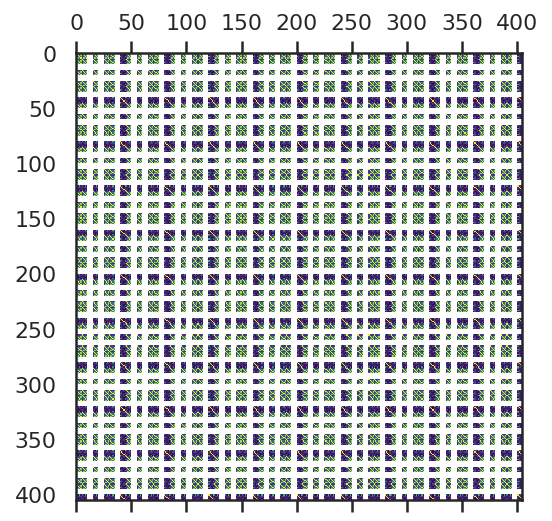

In [64]:
# Threshold for removing correlated variables
threshold = 0.95

# Absolute value correlation matrix
corr_matrix = features.corr().abs()
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))
plt.matshow(corr_matrix, cmap='viridis')

In [65]:
# Select columns with correlations above threshold
collinear_features = [column for column in upper.columns if any(upper[column] > threshold)]

print('There are %d features to remove.' % (len(collinear_features)))

There are 245 features to remove.


In [66]:
features_filtered = features.drop(columns = collinear_features)

print('The number of features that passed the collinearity threshold: ', features_filtered.shape[1])

The number of features that passed the collinearity threshold:  165


#### Test relevancy of generated features with another model.

In [67]:
# prep dataset for ModelSelection

features_positive = features_filtered.loc[:, features_filtered.ge(0).all()]

X_train_allcorr = features_positive[:traindata.shape[0]]
Y_train = traindata['Survived']

X_test_allcorr = features_positive[traindata.shape[0]:]

print(X_train_allcorr.shape, X_test_allcorr.shape)

(891, 65) (418, 65)


In [68]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.feature_selection import SelectFromModel

lsvc = GradientBoostingClassifier(learning_rate=0.01).fit(X_train_allcorr, Y_train)

model = SelectFromModel(lsvc, prefit=True)
X_new = model.transform(X_train_allcorr)

X_train_filtered = pd.DataFrame(X_new, columns=[X_train_allcorr.columns[i] for i in range(len(X_train_allcorr.columns)) if model.get_support()[i]])
print(X_train_filtered.columns)
X_train_filtered.shape

Index(['Pclass', 'Sex', 'Age', 'FamilySize', 'Deck',
       'Age.MODE(alldata.Pclass)', 'Age.MODE(alldata.Sex)',
       'Age.MODE(alldata.Prefix)', 'Age.MODE(alldata.Deck)'],
      dtype='object')


(891, 9)

In [ ]:
# filtering on our original non-DFS columns as well

X_mytrain = alldata.copy().loc[alldata['origin']=='train',:].drop(labels=['Survived','origin'], axis=1)
print(X_mytrain.shape)

lsvc = GradientBoostingClassifier(learning_rate=0.01).fit(X_mytrain, Y_train)

model = SelectFromModel(lsvc, prefit=True)
X_new = model.transform(X_mytrain)
print(X_new.shape)
X_mytrain_selected = pd.DataFrame(X_new, columns=[X_mytrain.columns[i] for i in range(len(X_mytrain.columns)) if model.get_support()[i]])
print(X_mytrain_selected.shape, X_mytrain_selected.columns)
allcols = set(alldata.columns) - {'Survived','origin'}
print(f'\nDiscarded Columns:\n{[col for col in allcols if col not in X_mytrain_selected.columns]}')

In [69]:
original_columns = set(ft_data.columns) - {'PassengerId'}
filtered_columns = set(X_train_filtered.columns)

append_columns = list(original_columns.union(filtered_columns))

X_train_final = X_train_allcorr.loc[:, append_columns]
X_test_final = X_test_allcorr.loc[:, append_columns]

print(X_train_final.shape, X_test_final.shape)

#check
X_train_final.iloc[323, :]

(891, 14) (418, 14)


Age                          2
Fare                         3
Embarked                     3
Age.MODE(alldata.Sex)        1
SibSp                        1
Sex                          1
Pclass                       2
Prefix                       8
FamilySize                   3
Deck                        10
Age.MODE(alldata.Pclass)     2
Age.MODE(alldata.Deck)      10
Age.MODE(alldata.Prefix)     8
Parch                        1
Name: 323, dtype: object

In [70]:
# check
X_test_final.head(1)

,Age,Fare,Embarked,Age.MODE(alldata.Sex),SibSp,Sex,Pclass,Prefix,FamilySize,Deck,Age.MODE(alldata.Pclass),Age.MODE(alldata.Deck),Age.MODE(alldata.Prefix),Parch
PassengerId,,,,,,,,,,,,,,
891,3,1,2,2,0,2,3,7,1,10,3,10,7,0


#### Load in Final Data

In [71]:
# rescale / typecast
for cols in  X_train_final.columns:
    X_train_final[cols] = X_train_final[cols].astype('float')
    
for cols in  X_test_final.columns:
    X_test_final[cols] = X_test_final[cols].astype('float')

# X_train_final = (X_train_final - X_train_final.mean())/X_train_final.std()
# X_test_final = (X_test_final - X_test_final.mean())/X_test_final.std()

X_test_final.shape

(418, 14)

## Model Building

### MLP

#### Prep Data

In [72]:
X_mlp_train = np.array(X_train_final.values, dtype=np.uint8)
Y_mlp_train = np.array(Y_train.values, dtype=np.uint8)

X_mlp_test = np.array(X_test_final.values, dtype=np.uint8)

print(X_mlp_train.shape, Y_mlp_train.shape)

(891, 14) (891,)


#### Model Architecture

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Linear-1                 [-1, 1, 3]              42
              ReLU-2                 [-1, 1, 3]               0
           Dropout-3                 [-1, 1, 3]               0
            Linear-4                 [-1, 1, 6]              24
              ReLU-5                 [-1, 1, 6]               0
           Dropout-6                 [-1, 1, 6]               0
            Linear-7                 [-1, 1, 9]              63
              ReLU-8                 [-1, 1, 9]               0
           Dropout-9                 [-1, 1, 9]               0
           Linear-10                 [-1, 1, 1]              10
Total params: 139
Trainable params: 139
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.00
Forward/backward pass size (MB): 0.00
Params size (MB): 0.00
Estimated Total Siz

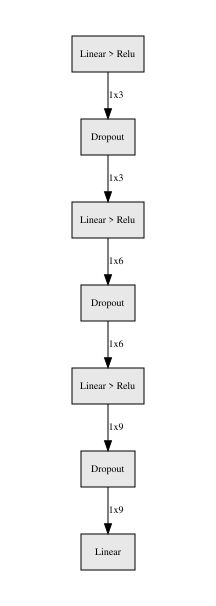

In [73]:
# make net

class MLP(nn.Module):
    
    def __init__(self, inputs,
                 numhidden, hiddensizes,
                 outputs, activation = 'relu', dropout_p = 0.0):
        super(MLP, self).__init__()
        
        self.activations = {'relu':nn.ReLU(), 'tanh':nn.Tanh(),
                            'selu':nn.SELU()}
        
        self.layers = tc.nn.ModuleList()

        if isinstance(hiddensizes, int):
            hiddensizes = [hiddensizes,]*numhidden

        layerdims = [(inputs, hiddensizes[0])]
        for x,y in zip(hiddensizes[:-1], hiddensizes[1:]):
            layerdims.append((x,y))
        
        for x,y in layerdims:
            self.layers.extend([nn.Linear(x,y),
                                self.activations[activation],
                                nn.Dropout(p=dropout_p)])
            
        self.output = nn.Linear(hiddensizes[-1], outputs)
        
    def forward(self, x):
        
        for each in self.layers:
            x = each(x)
        x = self.output(x) 
        return x
        

def make_net(inputs, numhidden,
             hiddensizes, outputs,
             activation=None, dropout_p=None):
    
    activations = ['relu','tanh','selu']
    
    def init_weights(module):
        if type(module) == nn.Linear:
            nn.init.xavier_uniform_(module.weight)
            nn.init.zeros_(module.bias)
    
    if isinstance(hiddensizes, int) and any((inputs, hiddensizes, outputs)) < 1:
        raise ValueError('Error in layer dimensions!')
    
    if numhidden < 1:
        raise ValueError('Error in number of hidden layers!')
    
    if not isinstance(hiddensizes, int):
        if len(hiddensizes) > 1 and len(hiddensizes)!=numhidden:
            raise ValueError('Wrong Dimensions for Hidden Layers!')
    
    if activation not in activations:
        if activation is None:
            activation = 'relu'
        else:
            raise ValueError('Activation not in {activations}!')
            
    if dropout_p is None:
        dropout_p = 0.0
        
    net = MLP(inputs, numhidden, hiddensizes,
              outputs, activation=activation)
    
    net = net.apply(init_weights)
    
    return net

#test 
testmodel = make_net(13,3,[3,6,9],1)
print(summary(testmodel.cuda(), (1,13), device='cuda'))
hl.build_graph(model=testmodel.cuda(), args=tc.randn(1,13).cuda())

#### Diagnostics: LR


Learning rate search finished. See the graph with {finder_name}.plot()


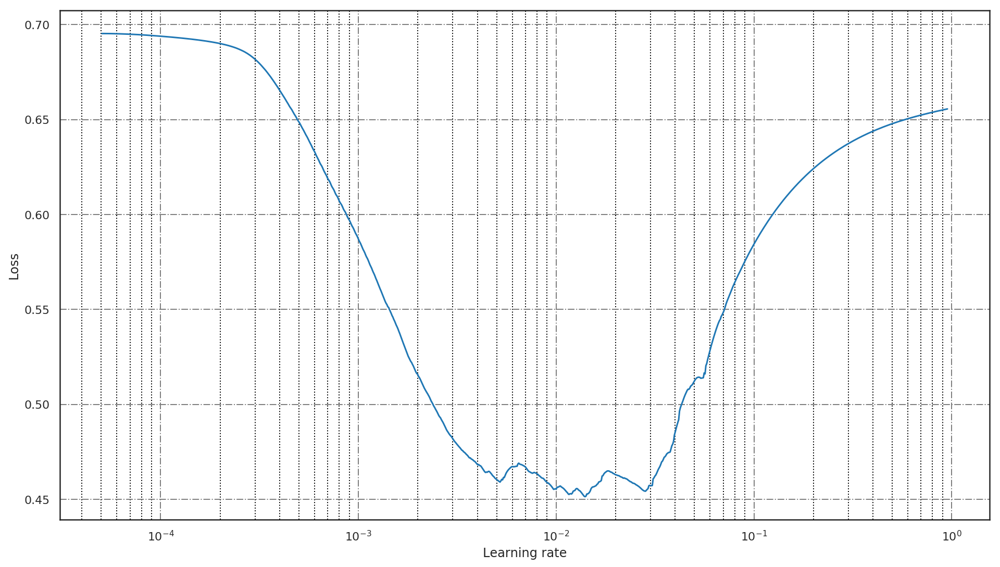

In [74]:
%autoreload 2
from lr_utils.lr_finder import LRFinder

# explore suitable learning rates, (Leslie L. Smith, 2015)
# data
trainloader = DataLoader(TensorDataset(Variable(tc.Tensor(X_mlp_train[:801]), requires_grad=False),
                                       Variable(tc.Tensor(Y_mlp_train[:801]), requires_grad=False).unsqueeze_(-1)),
                         batch_size=89, 
                         pin_memory=True)

valloader = DataLoader(TensorDataset(Variable(tc.Tensor(X_mlp_train[801:]), requires_grad=False),
                                       Variable(tc.Tensor(Y_mlp_train[801:]), requires_grad=False).unsqueeze_(-1)),
                         batch_size=89, 
                         pin_memory=True)

testmodel = make_net(inputs = X_mlp_train.shape[-1], numhidden = 15,
                     hiddensizes = 20, outputs = 1,
                     dropout_p=0.5, activation='relu').cuda()
# backend
tc.manual_seed(42); 
np.random.seed(42);
gc.collect();
tc.backends.cudnn.enabled = True
tc.backends.cudnn.benchmark = True
tc.backends.cudnn.deterministic = False
tc.cuda.empty_cache()
# test
testcriterion = nn.BCEWithLogitsLoss()
testoptim = optim.Adam(testmodel.parameters(), lr=5e-5)
lr_finder = LRFinder(testmodel, testoptim, testcriterion, device='cuda')
lr_finder.range_test(trainloader, val_loader=valloader, 
                     end_lr=1, num_iter=1000, 
                     step_mode='exp', smooth_f=0.01)
plt.figure(figsize=(16, 9));
lr_finder.plot(skip_start=0); lr_finder.reset();

* optimal learning ranges seems to lie between $4*10^{-3}$ to $4*10^{-2}$

* Implementation Goals for MLP Model:
    * Dropouts.
    * $L_1$ + $L_2$ Regularization.
    * Cyclic Cosine Annealing with Warm Restarts.
    * Ensemble of differentially seeded models.
        * Xavier Uniform Initialization for weights and zeros for bias.
        * Repeated random resampling of training data for training of all models in final ensemble.
* Undecided${^*}$.
    * Snapshotting and Divergence tracking with validation loss. 
    * M snapshots ensembling.
        * Switch samples after snapshot ?

In [75]:
# reference implementation
def dummycclr(nmin, nmax, Tcur, Tmax):
    if Tcur >= Tmax:
        Tcur_temp = Tcur - (Tcur//Tmax)*Tmax
    else:
        Tcur_temp = Tcur  
    Tt = Tcur_temp/Tmax
    ret = nmin + 0.5*(nmax-nmin)*(1 + np.cos(np.pi*(Tt)))
    return ret * (1 - 0.1*(Tcur//Tmax))

In [76]:
# hyperbolic tanh implementation
# SGD with Hyperbolic-Tangent Decay on Classification
def dummyctlr(nmin, nmax, tL, tU, Tcur, Tmax):
    if Tcur >= Tmax:
        Tcur_temp = Tcur - (Tcur//Tmax)*Tmax
    else:
        Tcur_temp = Tcur  
    Tt = Tcur_temp/Tmax
    ret = nmin + 0.5*(nmax-nmin)*(1 - np.tanh(tL*(1 - Tt) + tU*Tt))
    return ret * (1 - 0.1*(Tcur//Tmax))



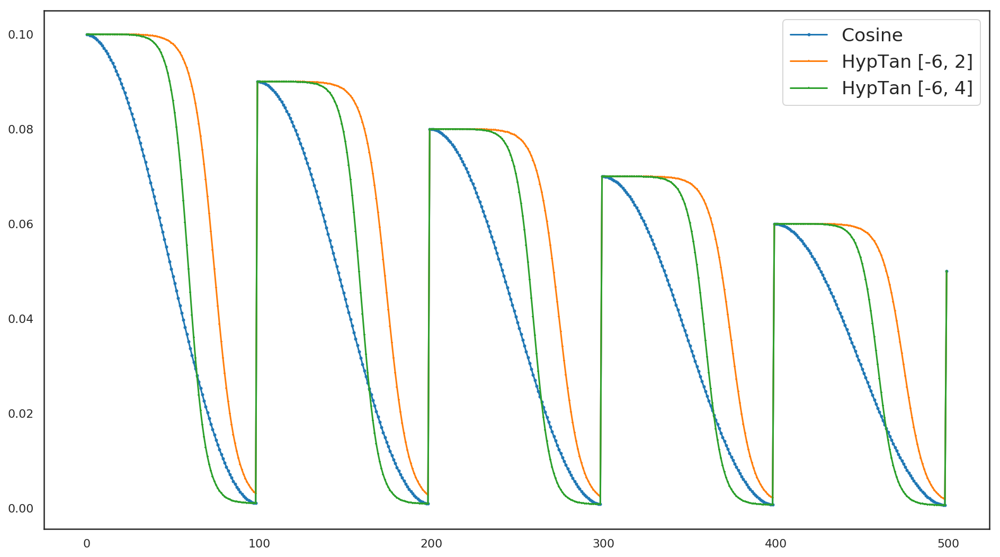

In [77]:
plt.figure(figsize=(16, 9))
plt.plot([dummycclr(0.001, 0.1, x, 100) for x in np.arange(1,501,1)], label='Cosine', marker='o', markersize=2)
plt.plot([dummyctlr(0.001, 0.1, -6, 2, x, 100) for x in np.arange(1,501,1)], label='HypTan [-6, 2]', marker='+', markersize=2)
plt.plot([dummyctlr(0.001, 0.1, -6, 4, x, 100) for x in np.arange(1,501,1)], label='HypTan [-6, 4]', marker='+', markersize=2)
plt.legend(fontsize='xx-large');

* The hyperbolic-tan can be adjusted by changing the ratio of the upper bound ${|(-)T_u|}$ to the lower bound ${|(+)T_b|}$.

##### Ordered Restart Sequencing with Cyclic LR. 
*LR is continuously restarted with cycles of increasing interval lengths, with the option to decay the ${\eta _{max}\ }$ at every restart.*
![Ordered cycling CLR to fit inside given epochs](./ordered_cyclingLR_comparison.png 'Custom LR cycling')

#### Training Methods

In [141]:
# helpers

def check_decay_params(net, l2_reg):
    decay, no_decay = [], []
    for name, param in net.named_parameters():
        if not param.requires_grad: continue
        if len(param.shape) == 1 or name.endswith('.bias'):
            no_decay.append(param)
        else:
            decay.append(param)
    return [{'params': no_decay, 'weight_decay': 0.0},
            {'params': decay, 'weight_decay': l2_reg}]

@njit(nogil = True)
def scale_lr(epochs = 600, restartfactor= 0.20, scaling=2):
    restartfactor = 1.0 if restartfactor == 0 else restartfactor
    budget = 1.00
    scale, idx = 1, 0
    lengths = np.zeros(int(1/restartfactor), dtype=np.int32)
    while True:
        tempscales = np.array([restartfactor, scaling, restartfactor*scaling])*scale
        lengths[idx] = np.round(tempscales[0] * epochs, 0)
        budget -= tempscales[0]
        scale = tempscales[1] if tempscales[-1] < budget else budget/restartfactor
        if budget < 1e-6:
            break
        idx += 1 
    lengths = np.cumsum(np.sort(lengths[lengths > 0]))
    return lengths

@njit(nogil = True)
def HTD_lr(lr_min, lr_max, epoch, epoch_max, tLb=-6, tUb=4):
    epoch += 1
    tT = np.round(epoch / epoch_max, 6)
    retval = lr_min + 0.5*(lr_max-lr_min)*(1 - np.tanh(tLb*(1 - tT) + tUb*tT))
    return np.float32(retval)

def get_scheduler(schedkey, optimizer, lr_min, lr_max, epochs_max):
    
    #optimizer.defaults['lr'] = lr_max
    if schedkey == 'cosine':
        
        for group in optimizer.param_groups:
            group['lr'] = lr_max
            try:
                group['initial_lr'] = lr_max
            except KeyError:
                pass
        
        scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer = optimizer,
                                                         eta_min = lr_min,
                                                         T_max = epochs_max)
        
    elif schedkey == 'hypertan':
        
        for group in optimizer.param_groups:
            group['lr'] = lr_max
        # pass 1 as lr_max, as Pytorch_lambda is going to mutiply it
        # with it's base_lrs
        scheduler_lambda = lambda x: HTD_lr(lr_min = lr_min,
                                            lr_max = lr_max,
                                            epoch = x,
                                            epoch_max = epochs_max)
        scheduler = optim.lr_scheduler.LambdaLR(optimizer = optimizer,
                                                lr_lambda = scheduler_lambda)
        
        scheduler.base_lrs = [1 for lr in scheduler.base_lrs]
        
    else:
        raise ValueError('key not implemented in schedulers!')
    return scheduler, optimizer
        

def train(model, X, Y, optimizer, loss_fn, l1_reg, wcuda=True):
    # does not move data and step optimizer and/or scheduler !
    model.train()
    optimizer.zero_grad()
    training_loss = 0.0
    l1 = tc.tensor(0.0)
    if wcuda:
        l1 = l1.to('cuda')
    logits = model(X)
    loss = loss_fn(logits, Y)
    # l1 reg
    for n, p in model.named_parameters():
        if 'bias' not in n and len(p.shape) == 1: 
            l1 += l1_reg*tc.sum(tc.abs(p))
    loss = loss + l1
    loss.backward()
    training_loss += loss.item()
    return model, optimizer, training_loss
    
def m_eval(model, X, Ytrue, wcuda=True):
    # does not move data
    with tc.no_grad():
        model.eval()
        pred = tc.sigmoid(model(X))
        train_acc = tc.eq(Ytrue, pred.round()).cpu().float().mean().item()
    return train_acc
        

In [137]:
# single batch fitting

def fit(model, X, Y, epochs=50,
        opt='adam', schedkey='hypertan',
        lr=0.001, l1_reg=0.0001, l2_reg=0.00001,
        restartfactor = None, lr_rescale=0.96,
        retmodel=False, wcuda=True):
    
    optimizers = {'adam':optim.Adam, 'sgd':optim.SGD,
                  'rmsprop':optim.RMSprop}
    decay_params = check_decay_params(model, l2_reg)
    try:
        optimizer = optimizers[opt](params=decay_params, lr=lr)
    except KeyError:
        raise KeyError('opt not in {optimizers.keys()}')
    # loss
    loss_fn = nn.BCEWithLogitsLoss()
    step, training_loss, train_acc, log_lr, step_lr = 0, 0.0, 0.0, 0.0, lr
    log_lrs = []
    # cyclic LR
    reset_count = 0
    reset_epochs = scale_lr(epochs = epochs, 
                            restartfactor = restartfactor,
                            scaling = 2)
    scheduler, optimizer = get_scheduler(schedkey = schedkey,
                                         optimizer = optimizer,
                                         lr_min = lr/12.5,
                                         lr_max = step_lr,
                                         epochs_max = reset_epochs[0])
    # tqdm
    desc = 'Iteration:{}, Acc:{:.4f} Loss:{:.4f} Lr:{:.4f}'
    pbar = tqdm(initial=0, leave=False, total=epochs,
                desc='Training:')
    for loop in range(epochs):
        # init stuff
        training_loss, train_acc = 0.0, 0.0
        step += 1
        # reset scheduler
        if step > 1 and (step-1) % reset_epochs[reset_count] == 0:
            # save previous state
            optimizerstate = optimizer.state_dict()
            # log to tqdm
            pbar.set_description(f'LR Refresh At:{step}, resetting next at {reset_epochs[reset_count]}')
            pbar.refresh()
            # re-adjust and reload optimizer
            step_lr = step_lr * lr_rescale
            optimizer = optimizers[opt](params=decay_params, lr=step_lr)
            optimizer.load_state_dict(optimizerstate)
            # update state
            reset_count += 1
            t_max = reset_epochs[reset_count]-(step-1)
            # reload new scheduler
            scheduler, optimizer = get_scheduler(schedkey = schedkey,
                                                 optimizer = optimizer,
                                                 lr_min = lr/8,
                                                 lr_max = step_lr,
                                                 epochs_max = t_max)
        scheduler.step()
        # log lr for tqdm
        log_lr = np.mean(scheduler.get_lr())
        log_lrs.append(log_lr)
        model, optimizer, loss = train(model = model,
                                       X = X, Y = Y,
                                       optimizer = optimizer, 
                                       loss_fn = loss_fn,
                                       l1_reg = l1_reg,
                                       wcuda = wcuda)
        training_loss += loss 
        optimizer.step()
        # eval training accuracy
        train_acc += m_eval(model = model, X = X, Ytrue = Y)
        # tqdm
        pbar.desc = desc.format(step, train_acc, training_loss, log_lr)
        pbar.set_description('Training:')
        pbar.update()
        
    pbar.close()
    if retmodel:
        return model, {'loss': training_loss, 'acc': train_acc}
    else:
        return {'loss': training_loss, 'acc': train_acc}

In [80]:
# mini-batching fits 
def fit_chunked(model, X, Y, epochs=50, chunks = 9,
                opt='adam', schedkey='hypertan',
                lr=0.001, l1_reg=0.0001, l2_reg=0.00001,
                restartfactor = None, lr_rescale=0.96,
                retmodel=False, wcuda=True):
    
    optimizers = {'adam':optim.Adam, 'sgd':optim.SGD,
                  'rmsprop':optim.RMSprop}
    decay_params = check_decay_params(model, l2_reg)
    try:
        optimizer = optimizers[opt](params=decay_params, lr=lr)
    except KeyError:
        raise KeyError('opt not in {optimizers.keys()}')
    # split data into batches
    X_chunked = tc.chunk(X, chunks=chunks)
    Y_chunked = tc.chunk(Y, chunks=chunks)
    # loss
    loss_fn = nn.BCEWithLogitsLoss()
    step, training_loss, train_acc, log_lr, step_lr = 0, 0.0, 0.0, 0.0, lr
    # cyclic LR
    reset_count = 0
    reset_epochs = scale_lr(epochs = epochs, 
                            restartfactor = restartfactor,
                            scaling = 2)
    scheduler, optimizer = get_scheduler(schedkey = schedkey,
                                         optimizer = optimizer,
                                         lr_min = lr/12.5,
                                         lr_max = step_lr,
                                         epochs_max = reset_epochs[0])
    # tqdm
    desc = 'Iteration:{}, Acc:{:.4f} Loss:{:.4f} Lr:{:.4f}'
    pbar = tqdm(initial=0, leave=False, total=epochs*chunks,
                desc='Training')
    
    for loop in range(epochs):
        training_loss, train_acc = [], 0.0
        step += 1
        # reset scheduler
        if step > 1 and (step-1) % reset_epochs[reset_count] == 0:
            # save previous state
            optimizerstate = optimizer.state_dict()
            # log to tqdm
            pbar.set_description(f'LR Refresh At:{step}, resetting next at {reset_epochs[reset_count]}')
            pbar.refresh()
            # re-adjust and reload optimizer
            step_lr = step_lr * lr_rescale
            optimizer = optimizers[opt](params=decay_params, lr=step_lr)
            optimizer.load_state_dict(optimizerstate)
            # update state
            reset_count += 1
            t_max = reset_epochs[reset_count]-(step-1)
            # reload new scheduler
            scheduler, optimizer = get_scheduler(schedkey = schedkey,
                                                 optimizer = optimizer,
                                                 lr_min = lr/8,
                                                 lr_max = step_lr,
                                                 epochs_max = t_max)
        scheduler.step()
        # log lr for tqdm
        log_lr = np.mean(scheduler.get_lr())
        # start batching
        for x, y in zip(X_chunked, Y_chunked):
            model, optimizer, loss = train(model = model,
                                       X = x, Y = y,
                                       optimizer = optimizer, 
                                       loss_fn = loss_fn,
                                       l1_reg = l1_reg,
                                       wcuda = wcuda)
            training_loss.append(loss)
            optimizer.step()
            pbar.update()
        # after epoch
        # eval training accuracy
        train_acc += m_eval(model = model, X = X, Ytrue = Y)
        # tqdm
        pbar.set_description('Training:')
        pbar.desc = desc.format(step, train_acc, np.mean(training_loss), log_lr)

    pbar.close()
    if retmodel:
        return model, {'loss': np.mean(training_loss), 'acc': train_acc}
    else:
        return {'loss': np.mean(training_loss), 'acc': train_acc}

In [81]:
def cv_scorer(model, X, Y, cv, epochs,
              optim, schedkey, lr,
              l1_reg, l2_reg, lr_rescale,
              restart_factor, wcuda=True):
    
    kfolds = StratifiedKFold(cv, shuffle=True).split(X, Y)
    
    scores = []
    desc = 'Fold:{}, Val_Acc:{:.4f}'
    pbar = tqdm(initial=0, leave=False, total=cv,
                desc='Testing CV-Folds')
    
    for ix, (train_idx, val_idx) in enumerate(kfolds):
        # split
        X_train = X[train_idx]
        Y_train = Y[train_idx]
        X_val = X[val_idx]
        Y_val = Y[val_idx]
        # tensorize and shape
        X_train = Variable(tc.Tensor(X_train),
                           requires_grad=False).pin_memory()
        Y_train = Variable(tc.Tensor(Y_train),
                           requires_grad=False).view(-1, 1).pin_memory()
        X_val = Variable(tc.Tensor(X_val),
                         requires_grad=False).pin_memory()
        Y_val = Variable(tc.Tensor(Y_val),
                         requires_grad=False).view(-1, 1).pin_memory()
        
        # get a complete copy for every fold
        train_model = copy.deepcopy(model)
        
        if wcuda:
            # set options
            gc.collect()
            tc.backends.cudnn.enabled = True
            tc.backends.cudnn.benchmark = True
            tc.backends.cudnn.deterministic = False
            tc.cuda.empty_cache()
            # move to device 
            train_model = train_model.cuda()
            X_train = X_train.cuda(non_blocking=True)
            Y_train = Y_train.cuda(non_blocking=True)
            X_val = X_val.cuda(non_blocking=True)
            Y_val = Y_val.cuda(non_blocking=True)
            
            
        metrics = fit(train_model, X_train, Y_train, 
                      epochs = epochs, opt = optim,
                      schedkey = schedkey, lr = lr,
                      l1_reg = l1_reg, l2_reg = l2_reg,
                      restartfactor = restart_factor,
                      lr_rescale = lr_rescale, wcuda=wcuda)
        
        train_model.eval()
        val_preds = tc.sigmoid(train_model(X_val))
        val_acc = tc.eq(Y_val, val_preds.round()).cpu().float().mean().item()
        scores.append(val_acc)
        
        pbar.desc = desc.format(ix+1, val_acc)
        pbar.update()
    
    #pbar.write(f'Mean k-fold validation accuracy: {np.mean(scores):.4f}\n')
    pbar.close()
    return scores
            

In [82]:
def do_grid_search(X, Y, paramgrid,
                   cv=9, epochs=50,
                   wcuda=True):
    
    grid = list((dict(zip(paramgrid, param))
                 for param in itertools.product(*paramgrid.values())))
    n_fits = len(grid)
    
    desc = 'Fit: {}/{} Mean CV Score: {}\n'
    pbar = tqdm(initial=0, leave=True, total=n_fits, desc='Grid-Search')
    
    grid_log = 'Fitting {} folds for each of {} permutations, totalling {} fits across {} searches.'
    pbar.write(grid_log.format(cv,n_fits,cv*n_fits,n_fits))
    
    _best_params, _best_model, _best_score = None, None, 0.0
    for select, params in enumerate(grid):
            
        dim_inp = X.shape[-1]
        n_hidden = params['n_hidden']
        dim_hidden = params['dims_hidden']
        dim_out = 1
        try:
            dropout = params['dropout']
            activatn = params['activation']
            optimizer = params['optimizer']
            schedkey = params['schedkey']
            lr_rescale = params['lr_rescale']
            lr = params['lr']
            l1reg = params['l1reg']
            l2reg = params['l2reg']
            seed = params['seed']
            restart_factor = params['restart_factor']
        except KeyError:
            raise KeyError(f'KeyError in Grid!')
            
        tc.manual_seed(seed)
        np.random.seed(seed)
        train_model = make_net(inputs = dim_inp,
                                   numhidden = n_hidden,
                                   hiddensizes = dim_hidden,
                                   outputs = dim_out,
                                   dropout_p = dropout,
                                   activation = activatn)
        
        cv_scores = cv_scorer(train_model, X, Y, 
                              cv = cv, epochs = epochs,
                              optim = optimizer, lr = lr,
                              l1_reg = l1reg, l2_reg = l2reg,
                              restart_factor = restart_factor,
                              schedkey = schedkey,
                              lr_rescale = lr_rescale, wcuda = wcuda)
        cv_mean_acc = np.mean(cv_scores)
        
        pbar.write(desc.format(select+1, n_fits, cv_mean_acc))
        pbar.update()
        
        if cv_mean_acc > _best_score:
            _best_params = params
            _best_model = train_model
            _best_score = cv_mean_acc
            
    pbar.write(f'Best Mean CV accuracy:{_best_score:.4f}')
    pbar.write(f'Best Model Parameters:\n{_best_params}')
    pbar.close()
        
    return {'_best_model':_best_model, '_best_params':_best_params,
            '_best_score':_best_score}

### Tuning hyperparameters with gridsearch

In [85]:
# start gridsearch!
# smaller net, with lower regularization
n_folds = 10

parameter_grid = {
    'n_hidden' : [3, 4, 5],
    'dims_hidden' : [9, 10, 11],
    'dropout' : [0.25],
    'lr' : [1e-2, 2e-2, 3e-2],
    'activation' : ['relu'],
    'optimizer' : ['adam'],
    'seed' : [42],
    'l1reg' : [1e-3],
    'l2reg' : [1e-3],
    'restart_factor' : [0.2],
    'schedkey' : ['hypertan', 'cosine'],
    'lr_rescale' : [0.96, 1.04]
}

best_model_s = do_grid_search(X_mlp_train, Y_mlp_train,
                            paramgrid = parameter_grid,
                            cv = n_folds, epochs = 600, 
                            wcuda = True)

Fitting 10 folds for each of 108 permutations, totalling 1080 fits across 108 searches.


Fit: 1/108 Mean CV Score: 0.8103311121463775



Fit: 2/108 Mean CV Score: 0.8159868240356445



Fit: 3/108 Mean CV Score: 0.8137274384498596



Fit: 4/108 Mean CV Score: 0.8148385465145112



Fit: 5/108 Mean CV Score: 0.8103688418865204



Fit: 6/108 Mean CV Score: 0.8081469178199768



Fit: 7/108 Mean CV Score: 0.8002817451953887



Fit: 8/108 Mean CV Score: 0.8047258973121643



Fit: 9/108 Mean CV Score: 0.8238148272037507



Fit: 10/108 Mean CV Score: 0.7912560939788819



Fit: 11/108 Mean CV Score: 0.7991828262805939



Fit: 12/108 Mean CV Score: 0.7802942335605622



Fit: 13/108 Mean CV Score: 0.8147886037826538



Fit: 14/108 Mean CV Score: 0.8136652946472168



Fit: 15/108 Mean CV Score: 0.8192705094814301



Fit: 16/108 Mean CV Score: 0.8226915180683136



Fit: 17/108 Mean CV Score: 0.8182098925113678



Fit: 18/108 Mean CV Score: 0.800231808423996



Fit: 19/108 Mean CV Score: 0.8047131299972534



Fit: 20/108 Mean CV Score: 0.8080339848995208



Fit: 21/108 Mean CV Score: 0.8114547014236451



Fit: 22/108 Mean CV Score: 0.8069725334644318



Fit: 23/108 Mean CV Score: 0.8103189110755921



Fit: 24/108 Mean CV Score: 0.8114047706127167



Fit: 25/108 Mean CV Score: 0.7946509897708893



Fit: 26/108 Mean CV Score: 0.8025544703006744



Fit: 27/108 Mean CV Score: 0.8114419400691986



Fit: 28/108 Mean CV Score: 0.8069603264331817



Fit: 29/108 Mean CV Score: 0.8002686858177185



Fit: 30/108 Mean CV Score: 0.8081471979618072



Fit: 31/108 Mean CV Score: 0.8047514379024505



Fit: 32/108 Mean CV Score: 0.8047137081623077



Fit: 33/108 Mean CV Score: 0.8080598056316376



Fit: 34/108 Mean CV Score: 0.8081344306468964



Fit: 35/108 Mean CV Score: 0.8103691339492798



Fit: 36/108 Mean CV Score: 0.8181971311569214



Fit: 37/108 Mean CV Score: 0.8148382604122162



Fit: 38/108 Mean CV Score: 0.8103305459022522



Fit: 39/108 Mean CV Score: 0.8081477582454681



Fit: 40/108 Mean CV Score: 0.814863520860672



Fit: 41/108 Mean CV Score: 0.8113786697387695



Fit: 42/108 Mean CV Score: 0.7934513568878174



Fit: 43/108 Mean CV Score: 0.7890080571174621



Fit: 44/108 Mean CV Score: 0.7901818692684174



Fit: 45/108 Mean CV Score: 0.815962427854538



Fit: 46/108 Mean CV Score: 0.8114430725574493



Fit: 47/108 Mean CV Score: 0.8036528110504151



Fit: 48/108 Mean CV Score: 0.737118935585022



Fit: 49/108 Mean CV Score: 0.8047505855560303



Fit: 50/108 Mean CV Score: 0.8115174174308777



Fit: 51/108 Mean CV Score: 0.7879599273204804



Fit: 52/108 Mean CV Score: 0.7946382224559784



Fit: 53/108 Mean CV Score: 0.8104199171066284



Fit: 54/108 Mean CV Score: 0.8170990705490112



Fit: 55/108 Mean CV Score: 0.8025289356708527



Fit: 56/108 Mean CV Score: 0.8114549875259399



Fit: 57/108 Mean CV Score: 0.811505776643753



Fit: 58/108 Mean CV Score: 0.8227167665958405



Fit: 59/108 Mean CV Score: 0.8249137341976166



Fit: 60/108 Mean CV Score: 0.8181843638420105



Fit: 61/108 Mean CV Score: 0.8081843674182891



Fit: 62/108 Mean CV Score: 0.803652536869049



Fit: 63/108 Mean CV Score: 0.8192702233791351



Fit: 64/108 Mean CV Score: 0.8148260653018952



Fit: 65/108 Mean CV Score: 0.815898859500885



Fit: 66/108 Mean CV Score: 0.820418506860733



Fit: 67/108 Mean CV Score: 0.8036025941371918



Fit: 68/108 Mean CV Score: 0.8048008024692536



Fit: 69/108 Mean CV Score: 0.814851313829422



Fit: 70/108 Mean CV Score: 0.8013934195041656



Fit: 71/108 Mean CV Score: 0.7913060307502746



Fit: 72/108 Mean CV Score: 0.8024670779705048



Fit: 73/108 Mean CV Score: 0.8058753192424775



Fit: 74/108 Mean CV Score: 0.7968604505062103



Fit: 75/108 Mean CV Score: 0.8036156415939331



Fit: 76/108 Mean CV Score: 0.8047258973121643



Fit: 77/108 Mean CV Score: 0.803665292263031



Fit: 78/108 Mean CV Score: 0.8036403238773346



Fit: 79/108 Mean CV Score: 0.8036269903182983



Fit: 80/108 Mean CV Score: 0.8002559185028076



Fit: 81/108 Mean CV Score: 0.8047003626823426



Fit: 82/108 Mean CV Score: 0.8047514379024505



Fit: 83/108 Mean CV Score: 0.7870113968849182



Fit: 84/108 Mean CV Score: 0.7858878016471863



Fit: 85/108 Mean CV Score: 0.8148254930973053



Fit: 86/108 Mean CV Score: 0.8238778114318848



Fit: 87/108 Mean CV Score: 0.8014178276062012



Fit: 88/108 Mean CV Score: 0.8103816211223602



Fit: 89/108 Mean CV Score: 0.8069350838661193



Fit: 90/108 Mean CV Score: 0.8092580199241638



Fit: 91/108 Mean CV Score: 0.8047888875007629



Fit: 92/108 Mean CV Score: 0.8081347107887268



Fit: 93/108 Mean CV Score: 0.8103694140911102



Fit: 94/108 Mean CV Score: 0.809183394908905



Fit: 95/108 Mean CV Score: 0.8070108354091644



Fit: 96/108 Mean CV Score: 0.8014056205749511



Fit: 97/108 Mean CV Score: 0.7968604564666748



Fit: 98/108 Mean CV Score: 0.8104068696498871



Fit: 99/108 Mean CV Score: 0.8069484114646912



Fit: 100/108 Mean CV Score: 0.7991189897060395



Fit: 101/108 Mean CV Score: 0.7844628870487214



Fit: 102/108 Mean CV Score: 0.7923535883426667



Fit: 103/108 Mean CV Score: 0.8046878814697266



Fit: 104/108 Mean CV Score: 0.776647937297821



Fit: 105/108 Mean CV Score: 0.8036026000976563



Fit: 106/108 Mean CV Score: 0.7934646964073181



Fit: 107/108 Mean CV Score: 0.7991453766822815



Fit: 108/108 Mean CV Score: 0.8025034070014954

Best Mean CV accuracy:0.8249
Best Model Parameters:
{'n_hidden': 4, 'dims_hidden': 10, 'dropout': 0.25, 'lr': 0.03, 'activation': 'relu', 'optimizer': 'adam', 'seed': 42, 'l1reg': 0.001, 'l2reg': 0.001, 'restart_factor': 0.2, 'schedkey': 'cosine', 'lr_rescale': 0.96}


In [86]:
# start gridsearch!
# deeper net with higher regularization
n_folds = 10

parameter_grid = {
    'n_hidden' : [9, 10, 11],
    'dims_hidden' : [8, 9, 10, 11],
    'dropout' : [0.5],
    'lr' : [1e-2, 3e-2],
    'activation' : ['relu'],
    'optimizer' : ['adam'],
    'seed' : [42],
    'l1reg' : [5e-3],
    'l2reg' : [5e-3],
    'restart_factor' : [0.2],
    'schedkey' : ['hypertan', 'cosine'],
    'lr_rescale' : [0.96, 1.04]
}

best_model_L = do_grid_search(X_mlp_train, Y_mlp_train,                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                             
                            paramgrid = parameter_grid,
                            cv = n_folds, epochs = 600, 
                            wcuda = True)

Fitting 10 folds for each of 96 permutations, totalling 960 fits across 96 searches.


Fit: 1/96 Mean CV Score: 0.7968610227108002



Fit: 2/96 Mean CV Score: 0.790144419670105



Fit: 3/96 Mean CV Score: 0.8002692639827729



Fit: 4/96 Mean CV Score: 0.7822789669036865



Fit: 5/96 Mean CV Score: 0.8047766864299775



Fit: 6/96 Mean CV Score: 0.7822417914867401



Fit: 7/96 Mean CV Score: 0.8069986283779145



Fit: 8/96 Mean CV Score: 0.7844886958599091



Fit: 9/96 Mean CV Score: 0.8081094563007355



Fit: 10/96 Mean CV Score: 0.8092455387115478



Fit: 11/96 Mean CV Score: 0.8047137081623077



Fit: 12/96 Mean CV Score: 0.8013551115989686



Fit: 13/96 Mean CV Score: 0.8002692580223083



Fit: 14/96 Mean CV Score: 0.789033305644989



Fit: 15/96 Mean CV Score: 0.8059124886989594



Fit: 16/96 Mean CV Score: 0.7258580088615417



Fit: 17/96 Mean CV Score: 0.8205070316791534



Fit: 18/96 Mean CV Score: 0.8137021780014038



Fit: 19/96 Mean CV Score: 0.818196564912796



Fit: 20/96 Mean CV Score: 0.809232771396637



Fit: 21/96 Mean CV Score: 0.7901574611663819



Fit: 22/96 Mean CV Score: 0.7856752812862396



Fit: 23/96 Mean CV Score: 0.7485217213630676



Fit: 24/96 Mean CV Score: 0.7227916657924652



Fit: 25/96 Mean CV Score: 0.815974622964859



Fit: 26/96 Mean CV Score: 0.8104068696498871



Fit: 27/96 Mean CV Score: 0.8002065539360046



Fit: 28/96 Mean CV Score: 0.8069606065750122



Fit: 29/96 Mean CV Score: 0.8148391127586365



Fit: 30/96 Mean CV Score: 0.8092336237430573



Fit: 31/96 Mean CV Score: 0.7719753623008728



Fit: 32/96 Mean CV Score: 0.701338654756546



Fit: 33/96 Mean CV Score: 0.6352712333202362



Fit: 34/96 Mean CV Score: 0.6363948285579681



Fit: 35/96 Mean CV Score: 0.6375184237957001



Fit: 36/96 Mean CV Score: 0.6352712333202362



Fit: 37/96 Mean CV Score: 0.76209254860878



Fit: 38/96 Mean CV Score: 0.7106066167354583



Fit: 39/96 Mean CV Score: 0.7126370370388031



Fit: 40/96 Mean CV Score: 0.6644847214221954



Fit: 41/96 Mean CV Score: 0.8058373034000397



Fit: 42/96 Mean CV Score: 0.8058373034000397



Fit: 43/96 Mean CV Score: 0.8047514379024505



Fit: 44/96 Mean CV Score: 0.8002065539360046



Fit: 45/96 Mean CV Score: 0.796899038553238



Fit: 46/96 Mean CV Score: 0.8014430701732635



Fit: 47/96 Mean CV Score: 0.7732405483722686



Fit: 48/96 Mean CV Score: 0.7271980881690979



Fit: 49/96 Mean CV Score: 0.8103186309337616



Fit: 50/96 Mean CV Score: 0.8081469178199768



Fit: 51/96 Mean CV Score: 0.8103444516658783



Fit: 52/96 Mean CV Score: 0.8114300191402435



Fit: 53/96 Mean CV Score: 0.709228789806366



Fit: 54/96 Mean CV Score: 0.6161701083183289



Fit: 55/96 Mean CV Score: 0.6970987796783448



Fit: 56/96 Mean CV Score: 0.6521549582481384



Fit: 57/96 Mean CV Score: 0.8125661015510559



Fit: 58/96 Mean CV Score: 0.8102811753749848



Fit: 59/96 Mean CV Score: 0.8148132860660553



Fit: 60/96 Mean CV Score: 0.7946135342121124



Fit: 61/96 Mean CV Score: 0.8081100225448609



Fit: 62/96 Mean CV Score: 0.8047766864299775



Fit: 63/96 Mean CV Score: 0.7745017528533935



Fit: 64/96 Mean CV Score: 0.7251134812831879



Fit: 65/96 Mean CV Score: 0.6161701083183289



Fit: 66/96 Mean CV Score: 0.6161701083183289



Fit: 67/96 Mean CV Score: 0.6161701083183289



Fit: 68/96 Mean CV Score: 0.6161701083183289



Fit: 69/96 Mean CV Score: 0.6161701083183289



Fit: 70/96 Mean CV Score: 0.6161701083183289



Fit: 71/96 Mean CV Score: 0.6161701083183289



Fit: 72/96 Mean CV Score: 0.6161701083183289



Fit: 73/96 Mean CV Score: 0.8193457007408143



Fit: 74/96 Mean CV Score: 0.8227162003517151



Fit: 75/96 Mean CV Score: 0.8159490883350372



Fit: 76/96 Mean CV Score: 0.8160123646259307



Fit: 77/96 Mean CV Score: 0.8170865893363952



Fit: 78/96 Mean CV Score: 0.8036026000976563



Fit: 79/96 Mean CV Score: 0.7348842263221741



Fit: 80/96 Mean CV Score: 0.7067943334579467



Fit: 81/96 Mean CV Score: 0.8125661015510559



Fit: 82/96 Mean CV Score: 0.8125533342361451



Fit: 83/96 Mean CV Score: 0.7991714775562286



Fit: 84/96 Mean CV Score: 0.7914053440093994



Fit: 85/96 Mean CV Score: 0.6161701083183289



Fit: 86/96 Mean CV Score: 0.6161701083183289



Fit: 87/96 Mean CV Score: 0.6161701083183289



Fit: 88/96 Mean CV Score: 0.6161701083183289



Fit: 89/96 Mean CV Score: 0.800231522321701



Fit: 90/96 Mean CV Score: 0.7991328954696655



Fit: 91/96 Mean CV Score: 0.759769594669342



Fit: 92/96 Mean CV Score: 0.750943124294281



Fit: 93/96 Mean CV Score: 0.6161701083183289



Fit: 94/96 Mean CV Score: 0.6161701083183289



Fit: 95/96 Mean CV Score: 0.6161701083183289



Fit: 96/96 Mean CV Score: 0.6161701083183289

Best Mean CV accuracy:0.8227
Best Model Parameters:
{'n_hidden': 11, 'dims_hidden': 9, 'dropout': 0.5, 'lr': 0.01, 'activation': 'relu', 'optimizer': 'adam', 'seed': 42, 'l1reg': 0.005, 'l2reg': 0.005, 'restart_factor': 0.2, 'schedkey': 'hypertan', 'lr_rescale': 1.04}


### Ensemble Training with tuned results

In [89]:
if best_model_L['_best_score'] > best_model_s['_best_score']:
    print('ensembling with larger nets')
    final_model_params = best_model_L['_best_params']
else:
    print('ensembling with small nets')
    final_model_params = best_model_s['_best_params']

ensembling with small nets


In [91]:
def ensembled_fit(model_params,
                  X = X_mlp_train,
                  Y = Y_mlp_train,
                  X_test = X_mlp_test,
                  ensemble_trials = 50,
                  epochs = 1,
                  wcuda = True):
    # try more so that we have atleast a good number of usable models in the
    # final ensemble, as some of our seeded models will be getting bad fits.
    seeds = np.random.randint(0, 1e6, (ensemble_trials))
    print(f'Model Seeds:\n{seeds}')
    
    [n_hidden, dims_hidden, dropout,
     lr, activation, optimizer,
     seed, l1reg, l2reg, restart_factor, 
     schedkey, lr_rescale] = [model_params[x] for x in model_params.keys()]
    
    final_model = partial(make_net, inputs = X.shape[-1],
                          numhidden = n_hidden, 
                          hiddensizes = dims_hidden,
                          outputs = 1, dropout_p = dropout, 
                          activation = activation)
    
    ensemble_dict = {ix: {'model':final_model,
                          'modelstate' : None,
                          'seed':_seed,
                          'train_acc':0.0,
                          'train_loss':0.0,
                          'val_acc':0.0} for ix, _seed in enumerate(seeds)}

    pbar = tqdm(initial=0, leave = True, 
                total = ensemble_trials, desc = 'Ensembler')
    
    for key in ensemble_dict.keys():
        
        tc.manual_seed(ensemble_dict[key]['seed'])
        np.random.seed(ensemble_dict[key]['seed'])
        
        # random splits for every ensembled model, so that they all learn differently
        x_train, x_val, y_train, y_val = train_test_split(X, Y,
                                                      random_state = 42,
                                                      shuffle = True,
                                                      test_size = 0.1)
    
        x_train = Variable(tc.Tensor(x_train), requires_grad=False).pin_memory()
        y_train = Variable(tc.Tensor(y_train), requires_grad=False).unsqueeze_(-1).pin_memory()
        x_val = Variable(tc.Tensor(x_val), requires_grad=False).pin_memory()
        y_val = Variable(tc.Tensor(y_val), requires_grad=False).unsqueeze_(-1).pin_memory()
        
        _model = ensemble_dict[key]['model']()
        
        if wcuda:
            gc.collect()
            tc.backends.cudnn.enabled = True
            tc.backends.cudnn.benchmark = True
            tc.backends.cudnn.deterministic = False
            tc.cuda.empty_cache()
            x_train = x_train.cuda(non_blocking = True)
            y_train = y_train.cuda(non_blocking = True)
            x_val = x_val.cuda(non_blocking = True)
            y_val = y_val.cuda(non_blocking = True)
            _model = _model.cuda()
            
        _model, metrics = fit_chunked(_model, x_train, y_train, 
                                      epochs = epochs, opt = optimizer,
                                      lr = lr, l1_reg = l1reg, 
                                      l2_reg = l2reg, chunks = 9,
                                      restartfactor = restart_factor,
                                      schedkey = schedkey,
                                      lr_rescale = lr_rescale,
                                      retmodel = True)
        
        ensemble_dict[key]['train_acc'] = metrics['acc']
        ensemble_dict[key]['train_loss'] = metrics['loss']
        
        # eval on test
        _model.eval()
        val_preds = tc.sigmoid(_model(x_val))
        val_acc = tc.eq(y_val, val_preds.round()).cpu().float().mean().item()
        ensemble_dict[key]['modelstate'] = copy.deepcopy(_model.state_dict())
        ensemble_dict[key]['val_acc'] = val_acc
        pbar.update()
        pbar.write(f'Model Number: {key+1} val_acc: {val_acc}')
        
    return ensemble_dict
 
# tryhard!
ensemble_dict = ensembled_fit(final_model_params,
                              ensemble_trials = 200,
                              epochs = 2400)

Model Seeds:
[399364 123090  44324  69541  33525 421784 263015  85355 598312 299920
 122965 702683 990762 834651 624162 343231 372667 320283 839056 960691
 125844 870257 196749 516801  16136 282271 179335 495997 663895 709874
 772203 681198 822037 384060 100635   7605 970185 740985 880409 436021
 708838 171713 810721 210755 244780  60992 424500 625667 859098 324113
 220063 319646  62585 485688 276077 955218  90490 168618 278281 651204
  94397 796833 483352 413373 547266 423853 143242 825125 350657 140695
 773238 636259 897527 535181 789378 522741 451506 476437 673078 166701
 609569 408504 978229 559482 526749 203727  48217 224479 974999  45854
 820243 512123 502673 945108 401412 668918 331367 330862 555225 796682
 509720 842766 614684 941004 876462 628210 177595 360498 837259 609579
  51992 398254 989175 801868  18369 328839 510931 859956 243013 650444
 131605 839703 285774 634901 753848 684215 259257 916989 875635 632922
 963694 307951 165875  53725 547223 508468 655336 669857 257311 

Model Number: 1 val_acc: 0.8222222328186035


Model Number: 2 val_acc: 0.8444444537162781


Model Number: 3 val_acc: 0.8111110925674438


Model Number: 4 val_acc: 0.8444444537162781


Model Number: 5 val_acc: 0.8444444537162781


Model Number: 6 val_acc: 0.7888888716697693


Model Number: 7 val_acc: 0.8111110925674438


Model Number: 8 val_acc: 0.8444444537162781


Model Number: 9 val_acc: 0.7666666507720947


Model Number: 10 val_acc: 0.8222222328186035


Model Number: 11 val_acc: 0.7777777910232544


Model Number: 12 val_acc: 0.8333333134651184


Model Number: 13 val_acc: 0.855555534362793


Model Number: 14 val_acc: 0.8444444537162781


Model Number: 15 val_acc: 0.8222222328186035


Model Number: 16 val_acc: 0.8111110925674438


Model Number: 17 val_acc: 0.855555534362793


Model Number: 18 val_acc: 0.8444444537162781


Model Number: 19 val_acc: 0.8111110925674438


Model Number: 20 val_acc: 0.800000011920929


Model Number: 21 val_acc: 0.855555534362793


Model Number: 22 val_acc: 0.8222222328186035


Model Number: 23 val_acc: 0.8111110925674438


Model Number: 24 val_acc: 0.8666666746139526


Model Number: 25 val_acc: 0.8444444537162781


Model Number: 26 val_acc: 0.855555534362793


Model Number: 27 val_acc: 0.855555534362793


Model Number: 28 val_acc: 0.8444444537162781


Model Number: 29 val_acc: 0.8111110925674438


Model Number: 30 val_acc: 0.8111110925674438


Model Number: 31 val_acc: 0.800000011920929


Model Number: 32 val_acc: 0.855555534362793


Model Number: 33 val_acc: 0.8333333134651184


Model Number: 34 val_acc: 0.8333333134651184


Model Number: 35 val_acc: 0.7777777910232544


Model Number: 36 val_acc: 0.8111110925674438


Model Number: 37 val_acc: 0.8444444537162781


Model Number: 38 val_acc: 0.8111110925674438


Model Number: 39 val_acc: 0.8666666746139526


Model Number: 40 val_acc: 0.855555534362793


Model Number: 41 val_acc: 0.855555534362793


Model Number: 42 val_acc: 0.8222222328186035


Model Number: 43 val_acc: 0.855555534362793


Model Number: 44 val_acc: 0.855555534362793


Model Number: 45 val_acc: 0.8111110925674438


Model Number: 46 val_acc: 0.855555534362793


Model Number: 47 val_acc: 0.8333333134651184


Model Number: 48 val_acc: 0.8222222328186035


Model Number: 49 val_acc: 0.8222222328186035


Model Number: 50 val_acc: 0.8444444537162781


Model Number: 51 val_acc: 0.800000011920929


Model Number: 52 val_acc: 0.8444444537162781


Model Number: 53 val_acc: 0.8111110925674438


Model Number: 54 val_acc: 0.8222222328186035


Model Number: 55 val_acc: 0.8444444537162781


Model Number: 56 val_acc: 0.8666666746139526


Model Number: 57 val_acc: 0.8222222328186035


Model Number: 58 val_acc: 0.8222222328186035


Model Number: 59 val_acc: 0.8333333134651184


Model Number: 60 val_acc: 0.8111110925674438


Model Number: 61 val_acc: 0.8444444537162781


Model Number: 62 val_acc: 0.800000011920929


Model Number: 63 val_acc: 0.8666666746139526


Model Number: 64 val_acc: 0.8222222328186035


Model Number: 65 val_acc: 0.855555534362793


Model Number: 66 val_acc: 0.8111110925674438


Model Number: 67 val_acc: 0.8222222328186035


Model Number: 68 val_acc: 0.800000011920929


Model Number: 69 val_acc: 0.8666666746139526


Model Number: 70 val_acc: 0.8222222328186035


Model Number: 71 val_acc: 0.855555534362793


Model Number: 72 val_acc: 0.8333333134651184


Model Number: 73 val_acc: 0.8222222328186035


Model Number: 74 val_acc: 0.800000011920929


Model Number: 75 val_acc: 0.8666666746139526


Model Number: 76 val_acc: 0.800000011920929


Model Number: 77 val_acc: 0.8666666746139526


Model Number: 78 val_acc: 0.7888888716697693


Model Number: 79 val_acc: 0.855555534362793


Model Number: 80 val_acc: 0.8111110925674438


Model Number: 81 val_acc: 0.8222222328186035


Model Number: 82 val_acc: 0.8333333134651184


Model Number: 83 val_acc: 0.8111110925674438


Model Number: 84 val_acc: 0.8444444537162781


Model Number: 85 val_acc: 0.8444444537162781


Model Number: 86 val_acc: 0.8222222328186035


Model Number: 87 val_acc: 0.8111110925674438


Model Number: 88 val_acc: 0.8333333134651184


Model Number: 89 val_acc: 0.8111110925674438


Model Number: 90 val_acc: 0.8333333134651184


Model Number: 91 val_acc: 0.8444444537162781


Model Number: 92 val_acc: 0.8444444537162781


Model Number: 93 val_acc: 0.8111110925674438


Model Number: 94 val_acc: 0.8222222328186035


Model Number: 95 val_acc: 0.8333333134651184


Model Number: 96 val_acc: 0.8333333134651184


Model Number: 97 val_acc: 0.8111110925674438


Model Number: 98 val_acc: 0.800000011920929


Model Number: 99 val_acc: 0.8111110925674438


Model Number: 100 val_acc: 0.8333333134651184


Model Number: 101 val_acc: 0.8444444537162781


Model Number: 102 val_acc: 0.8111110925674438


Model Number: 103 val_acc: 0.800000011920929


Model Number: 104 val_acc: 0.8111110925674438


Model Number: 105 val_acc: 0.8333333134651184


Model Number: 106 val_acc: 0.8111110925674438


Model Number: 107 val_acc: 0.855555534362793


Model Number: 108 val_acc: 0.8111110925674438


Model Number: 109 val_acc: 0.8777777552604675


Model Number: 110 val_acc: 0.8222222328186035


Model Number: 111 val_acc: 0.8111110925674438


Model Number: 112 val_acc: 0.8333333134651184


Model Number: 113 val_acc: 0.8444444537162781


Model Number: 114 val_acc: 0.8111110925674438


Model Number: 115 val_acc: 0.8333333134651184


Model Number: 116 val_acc: 0.8222222328186035


Model Number: 117 val_acc: 0.8222222328186035


Model Number: 118 val_acc: 0.855555534362793


Model Number: 119 val_acc: 0.8222222328186035


Model Number: 120 val_acc: 0.8111110925674438


Model Number: 121 val_acc: 0.8222222328186035


Model Number: 122 val_acc: 0.8333333134651184


Model Number: 123 val_acc: 0.855555534362793


Model Number: 124 val_acc: 0.855555534362793


Model Number: 125 val_acc: 0.8333333134651184


Model Number: 126 val_acc: 0.8222222328186035


Model Number: 127 val_acc: 0.8333333134651184


Model Number: 128 val_acc: 0.8444444537162781


Model Number: 129 val_acc: 0.7666666507720947


Model Number: 130 val_acc: 0.8333333134651184


Model Number: 131 val_acc: 0.8444444537162781


Model Number: 132 val_acc: 0.8111110925674438


Model Number: 133 val_acc: 0.8333333134651184


Model Number: 134 val_acc: 0.8333333134651184


Model Number: 135 val_acc: 0.8222222328186035


Model Number: 136 val_acc: 0.8333333134651184


Model Number: 137 val_acc: 0.8444444537162781


Model Number: 138 val_acc: 0.855555534362793


Model Number: 139 val_acc: 0.8666666746139526


Model Number: 140 val_acc: 0.8222222328186035


Model Number: 141 val_acc: 0.8111110925674438


Model Number: 142 val_acc: 0.8222222328186035


Model Number: 143 val_acc: 0.8111110925674438


Model Number: 144 val_acc: 0.8111110925674438


Model Number: 145 val_acc: 0.800000011920929


Model Number: 146 val_acc: 0.855555534362793


Model Number: 147 val_acc: 0.8222222328186035


Model Number: 148 val_acc: 0.8333333134651184


Model Number: 149 val_acc: 0.8444444537162781


Model Number: 150 val_acc: 0.8666666746139526


Model Number: 151 val_acc: 0.8333333134651184


Model Number: 152 val_acc: 0.8333333134651184


Model Number: 153 val_acc: 0.8111110925674438


Model Number: 154 val_acc: 0.855555534362793


Model Number: 155 val_acc: 0.855555534362793


Model Number: 156 val_acc: 0.8111110925674438


Model Number: 157 val_acc: 0.8444444537162781


Model Number: 158 val_acc: 0.855555534362793


Model Number: 159 val_acc: 0.8333333134651184


Model Number: 160 val_acc: 0.8222222328186035


Model Number: 161 val_acc: 0.8333333134651184


Model Number: 162 val_acc: 0.800000011920929


Model Number: 163 val_acc: 0.8333333134651184


Model Number: 164 val_acc: 0.8111110925674438


Model Number: 165 val_acc: 0.8222222328186035


Model Number: 166 val_acc: 0.8333333134651184


Model Number: 167 val_acc: 0.7666666507720947


Model Number: 168 val_acc: 0.8111110925674438


Model Number: 169 val_acc: 0.8666666746139526


Model Number: 170 val_acc: 0.8333333134651184


Model Number: 171 val_acc: 0.8222222328186035


Model Number: 172 val_acc: 0.8111110925674438


Model Number: 173 val_acc: 0.8333333134651184


Model Number: 174 val_acc: 0.8222222328186035


Model Number: 175 val_acc: 0.8444444537162781


Model Number: 176 val_acc: 0.7888888716697693


Model Number: 177 val_acc: 0.855555534362793


Model Number: 178 val_acc: 0.8222222328186035


Model Number: 179 val_acc: 0.8111110925674438


Model Number: 180 val_acc: 0.8333333134651184


Model Number: 181 val_acc: 0.8444444537162781


Model Number: 182 val_acc: 0.8444444537162781


Model Number: 183 val_acc: 0.7777777910232544


Model Number: 184 val_acc: 0.8444444537162781


Model Number: 185 val_acc: 0.8333333134651184


Model Number: 186 val_acc: 0.8666666746139526


Model Number: 187 val_acc: 0.8444444537162781


Model Number: 188 val_acc: 0.8333333134651184


Model Number: 189 val_acc: 0.8111110925674438


Model Number: 190 val_acc: 0.8111110925674438


Model Number: 191 val_acc: 0.8222222328186035


Model Number: 192 val_acc: 0.855555534362793


Model Number: 193 val_acc: 0.855555534362793


Model Number: 194 val_acc: 0.8111110925674438


Model Number: 195 val_acc: 0.8222222328186035


Model Number: 196 val_acc: 0.800000011920929


Model Number: 197 val_acc: 0.800000011920929


Model Number: 198 val_acc: 0.8444444537162781


Model Number: 199 val_acc: 0.800000011920929


Model Number: 200 val_acc: 0.800000011920929


In [96]:
# save
#sesionfile = './../saves/ensembledMLP_v2_NBstate.db'
#dill.dump_session(sesionfile)

with open('./../saves/ensemble_dict_scored.hdf5', mode='wb') as file:
    pickle.dump(ensemble_dict, file, protocol=-1)
    file.close()
    
#also copy data
data_store = {}
data_store['X_train'] = X_mlp_train
data_store['X_test'] = X_mlp_test
data_store['Y_train'] = Y_mlp_train

with open('./../saves/modelrun_data.hdf5', mode='wb') as file:
    pickle.dump(data_store, file, protocol=-1)
    file.close()

In [ ]:
# reload
with open('./../saves/ensemble_dict_scored.hdf5', mode='rb') as file:
    ensemble_dict = pickle.load(file)
    file.close()
    

with open('./../saves/modelrun_data.hdf5', mode='rb') as file:
    data_store = pickle.load(file)
    file.close()

In [195]:
def ensembler_transform(X = data_store['X_train'],
                        Y = None,
                        en_dict = ensemble_dict,
                        cutoff = 0.86,
                        getlogits = False,
                        wcuda = True):
    
    n_fits = np.sum([en_dict[k]['val_acc'] >= cutoff for k in en_dict.keys()])
    pbar = tqdm(initial=0, leave=True, total=n_fits, desc='Ensembled Transform')
    
    def loadmodel(ix, ens_dict=en_dict, cutoff = cutoff):
        
        if ens_dict[ix]['val_acc'] > cutoff:
            state = ens_dict[ix]['modelstate']
            _model = ens_dict[ix]['model']()
            _model.load_state_dict(state)
            return _model
        else:
            return None
        
    def getlogit(model, x, pbar):
        pbar.update()
        return model(x)
    
    selected = Parallel(n_jobs=-1)(delayed(loadmodel)(key) for key in en_dict.keys())
    selected = {ix:x for ix, x in enumerate([x for x in selected if x is not None])}
    
    X = Variable(tc.Tensor(X), requires_grad=False).pin_memory()
    yhat = Variable(tc.Tensor(np.zeros((X.shape[0], len(selected)))),
                    requires_grad=False).unsqueeze_(-1).pin_memory()
    preds = Variable(tc.Tensor(np.zeros((X.shape[0]))),
                     requires_grad=False).unsqueeze_(-1).pin_memory()
    if wcuda:
        X = X.cuda(non_blocking=True)
        yhat = yhat.cuda(non_blocking=True)
        preds = preds.cuda(non_blocking=True)
    # transform
    for key in selected.keys():
        selected[key].to('cuda').eval() if wcuda else selected[key].eval()
        yhat[:, key] = selected[key](X)
        pbar.update()
    # return logits
    if getlogits:
        yhat = yhat.view(yhat.shape[0], -1).cpu().float().detach().numpy()
        pbar.write(f'Logits Shape:{yhat.shape}')
        pbar.close()
        return yhat
    preds = tc.sigmoid(tc.mean(yhat, dim = 1))
    # optional eval
    if Y is not None:
        Y = Variable(tc.Tensor(Y), requires_grad = False).unsqueeze_(-1).pin_memory()
        if wcuda:
            Y = Y.cuda(non_blocking = True)
        val_acc = tc.eq(Y, preds.round()).cpu().float().mean().item()
        pbar.write(f'Validation Accuracy: {val_acc}')
        return val_acc
    else:
        preds = preds.view(-1).round().cpu().int().detach()
        pbar.write(f'{100*(np.sum(preds.numpy())/len(preds.numpy())):.2f}% Survived')
        return preds
        
ensembler_logits = ensembler_transform(getlogits = True)
ens_test = ensembler_transform(X = data_store['X_test'], getlogits = True)

Logits Shape:(891, 12)


Logits Shape:(418, 12)


In [197]:
def ens_refit(model_params,
              ens_X, ens_Y,
              seed = 42,
              epochs = 1000,
              wcuda = True):
    
    [n_hidden, dims_hidden, dropout,
     lr, activation, optimizer,
     seed, l1reg, l2reg, restart_factor, 
     schedkey, lr_rescale] = [model_params[x] for x in model_params.keys()]
    
    ens_model = partial(make_net, inputs = ens_X.shape[-1],
                          numhidden = n_hidden, 
                          hiddensizes = dims_hidden,
                          outputs = 1, dropout_p = dropout, 
                          activation = activation)
    
    ens_model = ens_model()
    ens_redict = {}
    ens_redict['seed'] = seed
    
    x_train, x_val, y_train, y_val = train_test_split(ens_X, ens_Y,
                                                      random_state = 42,
                                                      shuffle = True,
                                                      test_size = 0.1)
    
    x_train = Variable(tc.Tensor(x_train), requires_grad=False).pin_memory()
    y_train = Variable(tc.Tensor(y_train), requires_grad=False).unsqueeze_(-1).pin_memory()
    x_val = Variable(tc.Tensor(x_val), requires_grad=False).pin_memory()
    y_val = Variable(tc.Tensor(y_val), requires_grad=False).unsqueeze_(-1).pin_memory()

    pbar = tqdm(initial=0, leave = True, total = 1, desc = 'Re-Ensembler')
    
    if wcuda:
            gc.collect()
            tc.backends.cudnn.enabled = True
            tc.backends.cudnn.benchmark = True
            tc.backends.cudnn.deterministic = False
            tc.cuda.empty_cache()
            x_train = x_train.cuda(non_blocking = True)
            y_train = y_train.cuda(non_blocking = True)
            x_val = x_val.cuda(non_blocking = True)
            y_val = y_val.cuda(non_blocking = True)
            ens_model = ens_model.cuda()
    
    tc.manual_seed(seed)
    np.random.seed(seed)
        
    
    ens_model, metrics = fit_chunked(ens_model, x_train, y_train, 
                                     epochs = epochs, opt = optimizer,
                                     lr = lr, l1_reg = l1reg, 
                                     l2_reg = l2reg, chunks = 9,
                                     restartfactor = restart_factor,
                                     schedkey = schedkey,
                                     lr_rescale = lr_rescale,
                                     retmodel = True)
    
    ens_redict['modelstate'] = copy.deepcopy(ens_model.state_dict())   
    ens_redict['train_acc'] = metrics['acc']
    ens_redict['train_loss'] = metrics['loss']
        
    # eval on test
    ens_model.eval()
    val_pred = tc.sigmoid(ens_model(x_val))
    val_acc = tc.eq(y_val, val_pred.round()).cpu().float().mean().item()
    ens_redict['model'] = ens_model.cpu()
    ens_redict['val_acc'] = val_acc
    
    pbar.update()
    pbar.write(f'Re-ensembled Model val_acc: {val_acc}')
    pbar.close()
    
    return ens_redict

In [198]:
ens_regrid = {'n_hidden' : 4, 'dims_hidden' : 10,
            'dropout' : 0.25, 'lr' : 3e-2,
            'activation' : 'relu', 'optimizer' : 'adam',
            'seed' : 42, 'l1reg' : 5e-3, 'l2reg' : 5e-3,
            'restart_factor' : 0.2, 'schedkey' : 'hypertan',
            'lr_rescale' : 0.9 }

re_ens_dict = ens_refit(ens_grid, ens_X = ensembler_logits, ens_Y = Y_mlp_train, epochs = 1200)

Re-ensembled Model val_acc: 0.8444444537162781


In [214]:
re_ens_model = re_ens_dict['model'].cuda()
re_Xtest = Variable(tc.Tensor(ens_test), requires_grad=False).pin_memory().cuda()
re_Ytest = tc.zeros(ens_test.shape[0], 1).pin_memory().cuda()

re_Ytest = tc.sigmoid(re_ens_model(re_Xtest)).cpu().round().detach().view(-1).numpy()

In [215]:
test_survived = pd.Series(data = re_Ytest, name='Survived')

results = pd.concat([testdata['PassengerId'], test_survived.astype('int')], axis=1)

results.Survived.value_counts()

0    249
1    169
Name: Survived, dtype: int64

In [216]:
results.to_csv(os.getcwd()+'/../data/results/Final_Submission_MLP_remix.csv', index=False)